In [1]:
library(Seurat)

Attaching SeuratObject

Attaching sp



In [2]:
as_matrix <- function(mat){
    tmp <- matrix(data=0L, nrow = mat@Dim[1], ncol = mat@Dim[2])
    row_pos <- mat@i+1
    col_pos <- findInterval(seq(mat@x)-1,mat@p[-1])+1
    val <- mat@x
    for (i in seq_along(val)){
        tmp[row_pos[i],col_pos[i]] <- val[i]
    }

    row.names(tmp) <- mat@Dimnames[[1]]
    colnames(tmp) <- mat@Dimnames[[2]]
    return(tmp)
}


# load data

In [41]:
obj.merge <- readRDS("/data1/chenyx/HHCAd/Dataset20220412/Fetal.merged.rds")

In [3]:
obj.merge

An object of class Seurat 
43878 features across 117361 samples within 1 assay 
Active assay: RNA (43878 features, 0 variable features)

In [6]:
colnames(obj.merge@meta.data)

[1] "user_id"         "study_id"        "cell_id"         "organ"          
 [5] "region"          "subregion"       "seq_tech"        "sample_status"  
 [9] "donor_id"        "donor_gender"    "donor_age"       "original_name"  
[13] "cl_name"         "hcad_name"       "tissue_type"     "cell_type"      
[17] "marker_gene"     "cid"             "cell_type2"      "RNA_snn_res.0.5"
[21] "seurat_clusters" "RNA_snn_res.0.8"

# integration

In [42]:
organ.list <- SplitObject(obj.merge,split.by = "study_id")

In [47]:
organ.list[[1]]@assays$RNA@counts <- organ.list[[1]]@assays$RNA@data
organ.list[[3]]@assays$RNA@counts <- organ.list[[3]]@assays$RNA@data

In [48]:
features <- SelectIntegrationFeatures(object.list = organ.list)
organ.list <- lapply(X = organ.list, FUN = function(x) {
    x <- ScaleData(x, features = features, verbose = FALSE)
    x <- RunPCA(x, features = features, verbose = FALSE)
})

No variable features found for object1 in the object.list. Running FindVariableFeatures ...

No variable features found for object2 in the object.list. Running FindVariableFeatures ...

No variable features found for object3 in the object.list. Running FindVariableFeatures ...

No variable features found for object4 in the object.list. Running FindVariableFeatures ...



In [49]:
anchors <- FindIntegrationAnchors(object.list = organ.list, anchor.features = features, reduction = "rpca",k.anchor = 20)

Scaling features for provided objects

Computing within dataset neighborhoods

Finding all pairwise anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 16439 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 13881 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 16488 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 15910 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 19865 anchors

Projecting new data onto SVD

Projecting new data onto SVD

Finding neighborhoods

Finding anchors

	Found 12794 anchors



In [50]:
obj.int <- IntegrateData(anchorset = anchors)

Merging dataset 1 into 2

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 3 into 2 1

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data

Merging dataset 4 into 2 1 3

Extracting anchors for merged samples

Finding integration vectors

Finding integration vector weights

Integrating data



## conduct PCA on integrated reference data

In [51]:
DefaultAssay(obj.int) <- "integrated"

In [52]:
obj.int <- FindVariableFeatures(obj.int)
obj.int <- ScaleData(obj.int)
obj.int <- RunPCA(obj.int)

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
“selection.method set to 'vst' but count slot is empty; will use data slot instead”
Warning message in eval(predvars, data, env):
“NaNs produced”
Warning message in hvf.info$variance.expected[not.const] <- 10^fit$fitted:
“number of items to replace is not a multiple of replacement length”
Centering and scaling data matrix

PC_ 1 
Positive:  COL3A1, COL1A2, POSTN, FN1, SPARC, COL6A2, FBN1, COL1A1, DCN, COL5A1 
	   COL5A2, SMIM6, SPARCL1, LTBP4, IGF2, MMP2, CDH11, FBLN2, OGN, H19 
	   TFPI, LUM, ENG, COL12A1, MGP, MARCKS, TIMP1, HMCN1, CALCRL, COL14A1 
Negative:  TTN, MYL7, ACTC1, TPM1, TNNT2, TNNI3, MYL4, MYH7, TNNI1, MYL3 
	   MYL9, SORBS2, MYL2, LDB3, SLC8A1, PLN, CKM, HSPB7, NPPA, FGF12 
	   CRYAB, RYR2, NEBL, ACTN2, FABP3, FHL2, PDLIM5, HSPB1, PPP1R12B, CSRP3 
PC_ 2 
Positive:  EMCN, CALCRL, HLA-E, LEPR, ENG, HSPG2, RAMP2, CD93, CDH11, FOXC1 
	   PRCP, PLVAP, HMCN1, CD9, VWF, GJ

## save integrated reference data

In [54]:
saveRDS(obj.int,"/data3/cyx/Fetal.Heart.integrated.rds")

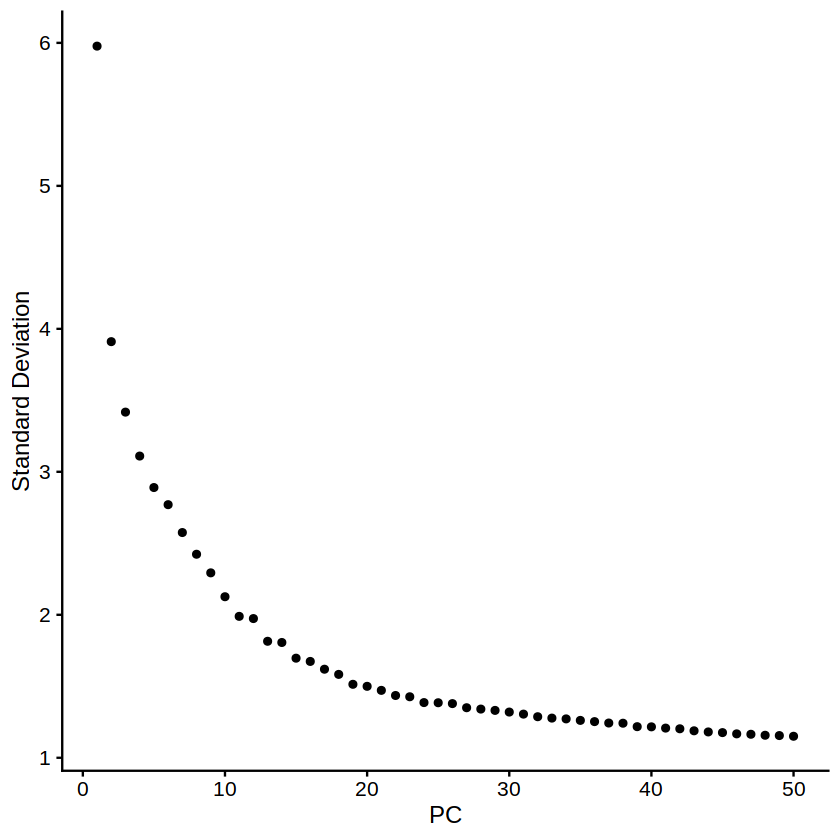

In [53]:
ElbowPlot(obj.int, ndims = 50)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



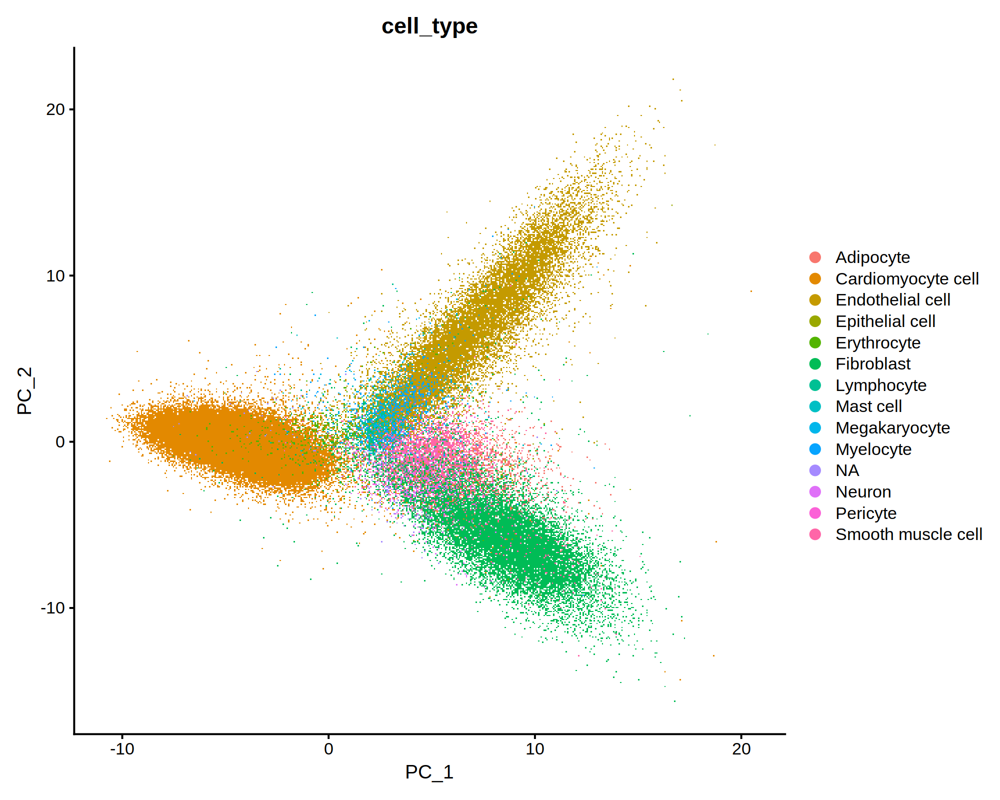

In [57]:
options(repr.plot.width=10, repr.plot.height=8, repr.plot.res = 200)
DimPlot(obj.int,group.by = "cell_type")

In [58]:
obj.int <- RunUMAP(obj.int,dims = 1:30)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
16:04:01 UMAP embedding parameters a = 0.9922 b = 1.112

16:04:01 Read 117361 rows and found 30 numeric columns

16:04:01 Using Annoy for neighbor search, n_neighbors = 30

16:04:01 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

16:04:13 Writing NN index file to temp file /tmp/RtmpxjKQgm/file1b401c4ed4a7ba

16:04:13 Searching Annoy index using 1 thread, search_k = 3000

16:04:57 Annoy recall = 100%

16:04:57 Commencing smooth kNN distance calibration using 1 thread

16:05:02 Initializing

In [62]:
obj.int <- RunTSNE(obj.int,dims = 1:30)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



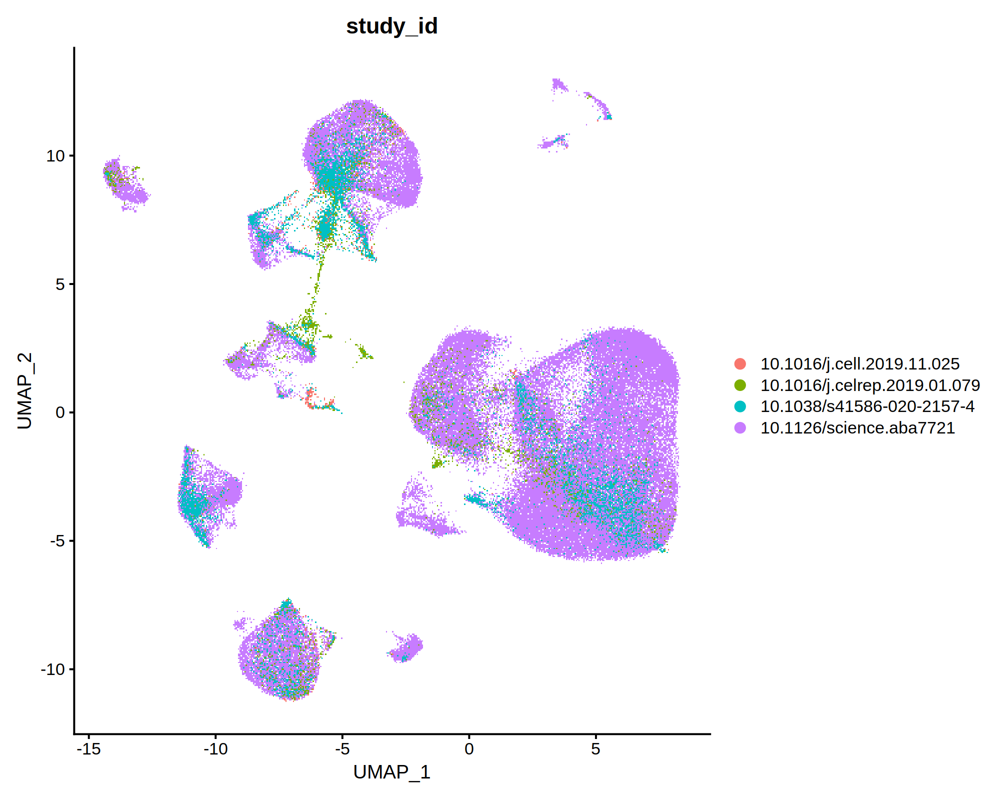

In [59]:
options(repr.plot.width=10, repr.plot.height=8, repr.plot.res = 200)
DimPlot(obj.int,reduction = "umap",group.by = "study_id")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



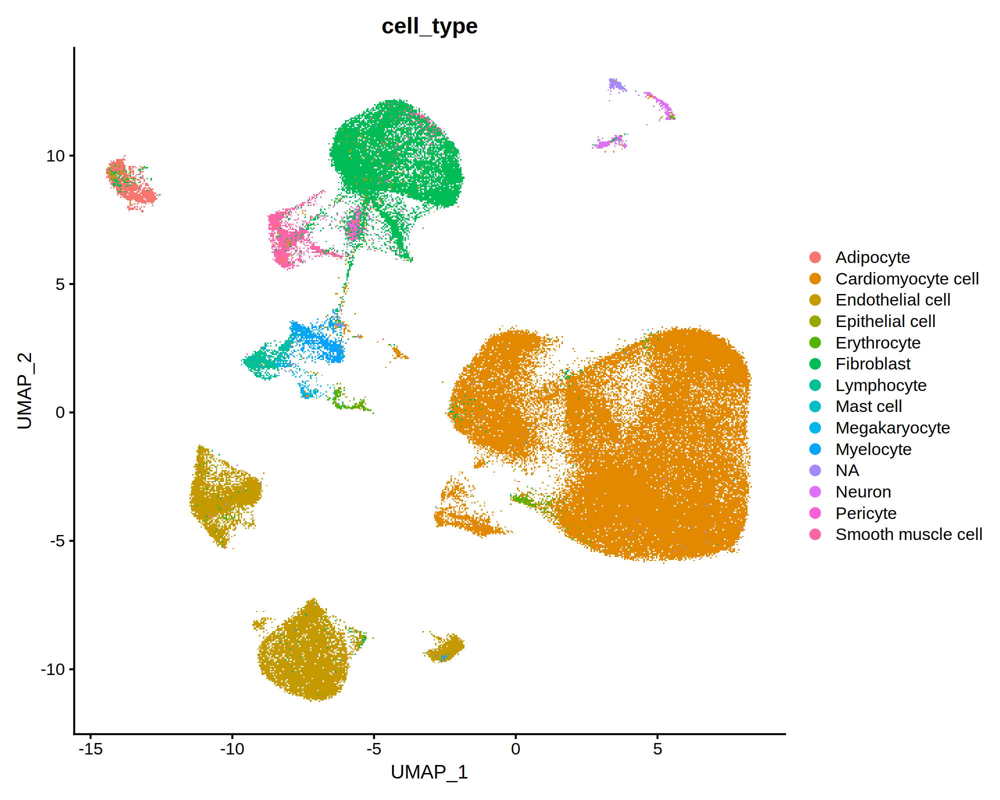

In [60]:
options(repr.plot.width=10, repr.plot.height=8, repr.plot.res = 200)
DimPlot(obj.int,reduction = "umap",group.by = "cell_type")

In [88]:
obj.int$PC_1 <- obj.int@reductions$pca@cell.embeddings[,1]
obj.int$PC_2 <- obj.int@reductions$pca@cell.embeddings[,2]

obj.int$TSNE_1 <- obj.int@reductions$tsne@cell.embeddings[,1]
obj.int$TSNE_2 <- obj.int@reductions$tsne@cell.embeddings[,2]

obj.int$UMAP_1 <- obj.int@reductions$umap@cell.embeddings[,1]
obj.int$UMAP_2 <- obj.int@reductions$umap@cell.embeddings[,2]

# Standardize Metadata

In [66]:
unique(obj.int$region)

[1] "NA"               "Atria"            "Ventricle"        "Aorta"           
[5] "Valve"            "Pulmonary artery"

In [67]:
unique(obj.int$subregion)

[1] "NA"                      "Left atria"             
 [3] "Left ventricle"          "Right atria"            
 [5] "Right ventricle"         "Aorta"                  
 [7] "Aortic valve"            "Mitral valve"           
 [9] "Interventricular septum" "Pulmonary artery"       
[11] "Pulmonary valve"         "Tricuspid valve"        
[13] "Ventricle"

In [75]:
colnames(obj.int@meta.data)

[1] "user_id"         "study_id"        "cell_id"         "organ"          
 [5] "region"          "subregion"       "seq_tech"        "sample_status"  
 [9] "donor_id"        "donor_gender"    "donor_age"       "original_name"  
[13] "cl_name"         "hcad_name"       "tissue_type"     "cell_type"      
[17] "marker_gene"     "cid"             "cell_type2"      "RNA_snn_res.0.5"
[21] "seurat_clusters" "RNA_snn_res.0.8" "nCount_RNA"      "nFeature_RNA"   
[25] "PC_1"            "PC_2"            "TSNE_1"          "TSNE_2"         
[29] "UMAP_1"          "UMAP_2"

In [78]:
obj.int@meta.data <- obj.int@meta.data[,c("cell_id","donor_id","donor_gender","donor_age","original_name",'organ','region','subregion','sample_status','seq_tech','cell_type2',"study_id","cell_type",'PC_1','PC_2','TSNE_1','TSNE_2','UMAP_1','UMAP_2')]

In [80]:
colnames(obj.int@meta.data)<- c("cell_ID","donor_ID","donor_gender","donor_age","original_name",'organ','region','subregion','sample_status','seq_tech','cell_type',"Ref","MCT",'PC_1','PC_2','TSNE_1','TSNE_2','UMAP_1','UMAP_2')

In [84]:
obj.int@meta.data

,cell_ID,donor_ID,donor_gender,donor_age,original_name,organ,region,subregion,sample_status,seq_tech,⋯,PC_2,TSNE_1,TSNE_2,UMAP_1,UMAP_2,if_patient,donor_status,treatment,ethnicity,develop_stage
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
AAACCTGAGAAACCAT.1,AAACCTGAGAAACCAT.1,Asp_donor1,Female,HE7W,Erythrocytes,Heart,NA,NA,Healthy,10X,⋯,-0.7900906,6.66757372,20.8015857,-5.684747,0.4495210,No,Healthy,None,NA,Fetal
AAACCTGGTGGTACAG.1,AAACCTGGTGGTACAG.1,Asp_donor1,Female,HE7W,Epicardium-derivedcells,Heart,NA,NA,Healthy,10X,⋯,-2.4651020,7.52374726,-13.1658802,-5.943957,7.6454328,No,Healthy,None,NA,Fetal
AAACGGGAGATGTAAC.1,AAACGGGAGATGTAAC.1,Asp_donor1,Female,HE7W,Fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-5.6398096,10.00009241,-15.0804197,-4.361122,9.8685745,No,Healthy,None,NA,Fetal
AAACGGGAGGCAGTCA.1,AAACGGGAGGCAGTCA.1,Asp_donor1,Female,HE7W,Fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-5.2410161,10.28395583,-14.7993946,-4.537375,9.3946499,No,Healthy,None,NA,Fetal
AAACGGGAGGTCATCT.1,AAACGGGAGGTCATCT.1,Asp_donor1,Female,HE7W,Smoothmusclecells/fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-6.7805783,0.12400437,-23.6637435,-2.881997,11.0526184,No,Healthy,None,NA,Fetal
AAACGGGAGTAGCCGA.1,AAACGGGAGTAGCCGA.1,Asp_donor1,Female,HE7W,Fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-1.8254313,-18.75117821,10.3479759,-2.157959,0.4619591,No,Healthy,None,NA,Fetal
AAACGGGAGTTCGCGC.1,AAACGGGAGTTCGCGC.1,Asp_donor1,Female,HE7W,Smoothmusclecells/fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-5.2027281,0.11516581,-23.6909892,-2.889949,11.2032741,No,Healthy,None,NA,Fetal
AAACGGGCAAGCCTAT.1,AAACGGGCAAGCCTAT.1,Asp_donor1,Female,HE7W,Fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-1.9319238,6.74843139,-10.2218622,-4.146063,6.5322989,No,Healthy,None,NA,Fetal
AAACGGGTCATTATCC.1,AAACGGGTCATTATCC.1,Asp_donor1,Female,HE7W,Smoothmusclecells/fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-5.9813034,0.01356109,-23.6858583,-2.779075,11.0916694,No,Healthy,None,NA,Fetal


In [81]:
obj.int@meta.data$if_patient <- "No"
obj.int@meta.data$donor_status <- "Healthy"
obj.int@meta.data$treatment <- "None"
obj.int@meta.data$ethnicity <- "NA"
obj.int@meta.data$develop_stage <- "Fetal"

In [85]:
obj.int@meta.data

,cell_ID,donor_ID,donor_gender,donor_age,original_name,organ,region,subregion,sample_status,seq_tech,⋯,PC_2,TSNE_1,TSNE_2,UMAP_1,UMAP_2,if_patient,donor_status,treatment,ethnicity,develop_stage
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>
AAACCTGAGAAACCAT.1,AAACCTGAGAAACCAT.1,Asp_donor1,Female,HE7W,Erythrocytes,Heart,NA,NA,Healthy,10X,⋯,-0.7900906,6.66757372,20.8015857,-5.684747,0.4495210,No,Healthy,None,NA,Fetal
AAACCTGGTGGTACAG.1,AAACCTGGTGGTACAG.1,Asp_donor1,Female,HE7W,Epicardium-derivedcells,Heart,NA,NA,Healthy,10X,⋯,-2.4651020,7.52374726,-13.1658802,-5.943957,7.6454328,No,Healthy,None,NA,Fetal
AAACGGGAGATGTAAC.1,AAACGGGAGATGTAAC.1,Asp_donor1,Female,HE7W,Fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-5.6398096,10.00009241,-15.0804197,-4.361122,9.8685745,No,Healthy,None,NA,Fetal
AAACGGGAGGCAGTCA.1,AAACGGGAGGCAGTCA.1,Asp_donor1,Female,HE7W,Fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-5.2410161,10.28395583,-14.7993946,-4.537375,9.3946499,No,Healthy,None,NA,Fetal
AAACGGGAGGTCATCT.1,AAACGGGAGGTCATCT.1,Asp_donor1,Female,HE7W,Smoothmusclecells/fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-6.7805783,0.12400437,-23.6637435,-2.881997,11.0526184,No,Healthy,None,NA,Fetal
AAACGGGAGTAGCCGA.1,AAACGGGAGTAGCCGA.1,Asp_donor1,Female,HE7W,Fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-1.8254313,-18.75117821,10.3479759,-2.157959,0.4619591,No,Healthy,None,NA,Fetal
AAACGGGAGTTCGCGC.1,AAACGGGAGTTCGCGC.1,Asp_donor1,Female,HE7W,Smoothmusclecells/fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-5.2027281,0.11516581,-23.6909892,-2.889949,11.2032741,No,Healthy,None,NA,Fetal
AAACGGGCAAGCCTAT.1,AAACGGGCAAGCCTAT.1,Asp_donor1,Female,HE7W,Fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-1.9319238,6.74843139,-10.2218622,-4.146063,6.5322989,No,Healthy,None,NA,Fetal
AAACGGGTCATTATCC.1,AAACGGGTCATTATCC.1,Asp_donor1,Female,HE7W,Smoothmusclecells/fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,-5.9813034,0.01356109,-23.6858583,-2.779075,11.0916694,No,Healthy,None,NA,Fetal


In [86]:
obj.int@meta.data <- obj.int@meta.data[,c("cell_ID", "donor_ID", "donor_gender", "donor_age", "original_name", "organ", "region","subregion", "sample_status", "seq_tech", "cell_type", "if_patient", "donor_status", "treatment", "ethnicity", "Ref", "MCT", "develop_stage",'PC_1','PC_2','TSNE_1','TSNE_2','UMAP_1','UMAP_2')]

In [89]:
obj.int@meta.data

,cell_ID,donor_ID,donor_gender,donor_age,original_name,organ,region,subregion,sample_status,seq_tech,⋯,ethnicity,Ref,MCT,develop_stage,PC_1,PC_2,TSNE_1,TSNE_2,UMAP_1,UMAP_2
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
AAACCTGAGAAACCAT.1,AAACCTGAGAAACCAT.1,Asp_donor1,Female,HE7W,Erythrocytes,Heart,NA,NA,Healthy,10X,⋯,NA,10.1016/j.cell.2019.11.025,Erythrocyte,Fetal,-1.25923729,-0.7900906,6.66757372,20.8015857,-5.684747,0.4495210
AAACCTGGTGGTACAG.1,AAACCTGGTGGTACAG.1,Asp_donor1,Female,HE7W,Epicardium-derivedcells,Heart,NA,NA,Healthy,10X,⋯,NA,10.1016/j.cell.2019.11.025,Fibroblast,Fetal,6.29901100,-2.4651020,7.52374726,-13.1658802,-5.943957,7.6454328
AAACGGGAGATGTAAC.1,AAACGGGAGATGTAAC.1,Asp_donor1,Female,HE7W,Fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,NA,10.1016/j.cell.2019.11.025,Fibroblast,Fetal,8.16451597,-5.6398096,10.00009241,-15.0804197,-4.361122,9.8685745
AAACGGGAGGCAGTCA.1,AAACGGGAGGCAGTCA.1,Asp_donor1,Female,HE7W,Fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,NA,10.1016/j.cell.2019.11.025,Fibroblast,Fetal,9.24017824,-5.2410161,10.28395583,-14.7993946,-4.537375,9.3946499
AAACGGGAGGTCATCT.1,AAACGGGAGGTCATCT.1,Asp_donor1,Female,HE7W,Smoothmusclecells/fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,NA,10.1016/j.cell.2019.11.025,Smooth muscle cell,Fetal,9.49116422,-6.7805783,0.12400437,-23.6637435,-2.881997,11.0526184
AAACGGGAGTAGCCGA.1,AAACGGGAGTAGCCGA.1,Asp_donor1,Female,HE7W,Fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,NA,10.1016/j.cell.2019.11.025,Fibroblast,Fetal,0.00423586,-1.8254313,-18.75117821,10.3479759,-2.157959,0.4619591
AAACGGGAGTTCGCGC.1,AAACGGGAGTTCGCGC.1,Asp_donor1,Female,HE7W,Smoothmusclecells/fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,NA,10.1016/j.cell.2019.11.025,Smooth muscle cell,Fetal,7.41102684,-5.2027281,0.11516581,-23.6909892,-2.889949,11.2032741
AAACGGGCAAGCCTAT.1,AAACGGGCAAGCCTAT.1,Asp_donor1,Female,HE7W,Fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,NA,10.1016/j.cell.2019.11.025,Fibroblast,Fetal,3.08266608,-1.9319238,6.74843139,-10.2218622,-4.146063,6.5322989
AAACGGGTCATTATCC.1,AAACGGGTCATTATCC.1,Asp_donor1,Female,HE7W,Smoothmusclecells/fibroblast-like,Heart,NA,NA,Healthy,10X,⋯,NA,10.1016/j.cell.2019.11.025,Smooth muscle cell,Fetal,9.62253940,-5.9813034,0.01356109,-23.6858583,-2.779075,11.0916694


# reannoatate

In [90]:
saveRDS(obj.int,"/data3/cyx/Fetal.Heart.integrated.rds")

# Reannoatate

In [3]:
obj.int <- readRDS("/data3/cyx/Fetal.Heart.integrated.rds")

In [4]:
dataobj <- obj.int

In [5]:
dataobj <- FindNeighbors(dataobj, reduction = "pca", dims = 1:30, nn.eps = 0.5)
dataobj <- FindClusters(dataobj, resolution = 0.5, n.start = 10)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 117361
Number of edges: 4081315

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9271
Number of communities: 30
Elapsed time: 46 seconds


9 singletons identified. 21 final clusters.



Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



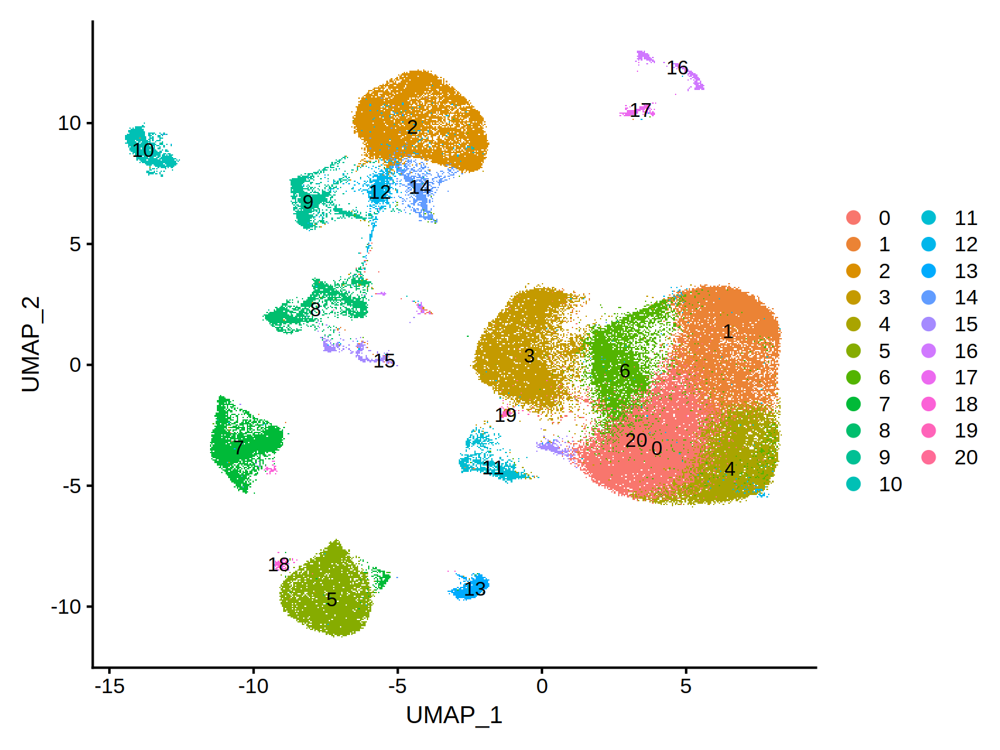

In [6]:
options(repr.plot.width=8, repr.plot.height=6, repr.plot.res = 200)
DimPlot(dataobj,label = T)

### Fibroblast

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



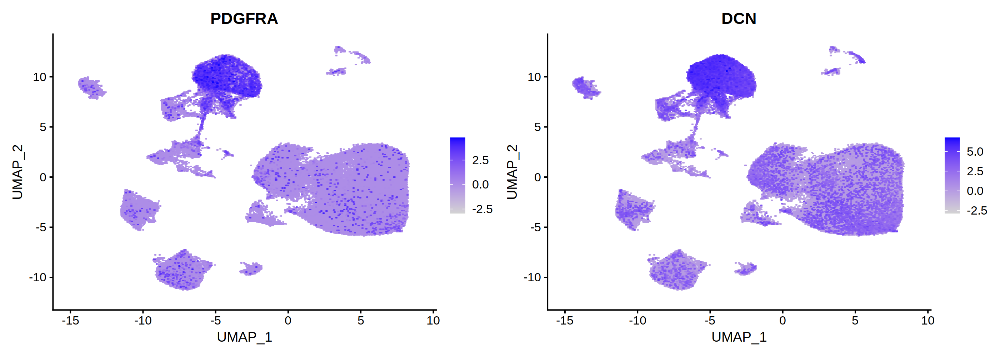

In [100]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1
FeaturePlot(dataobj,features = c("PDGFRA","DCN"),pt.size = pt.size,order = T,ncol=2)

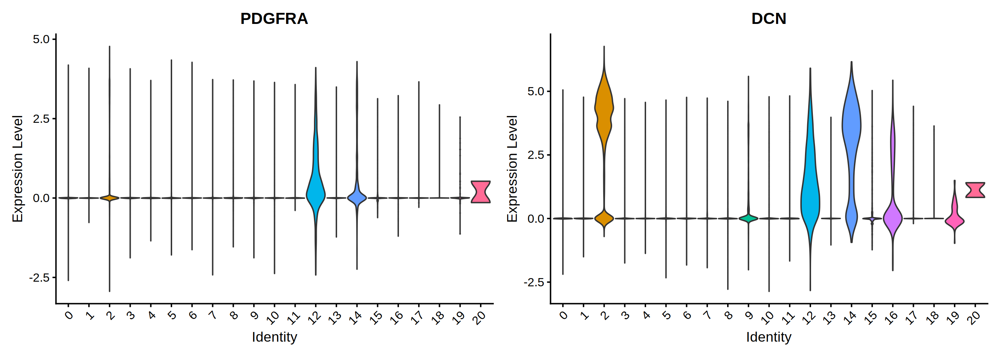

In [101]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)

VlnPlot(dataobj,features = c("PDGFRA","DCN"),pt.size = 0,ncol=2)

In [7]:
dataobj <- RenameIdents(object = dataobj,'2' = 'Fibroblast','12' = 'Fibroblast','14' = 'Fibroblast')

### SMC

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



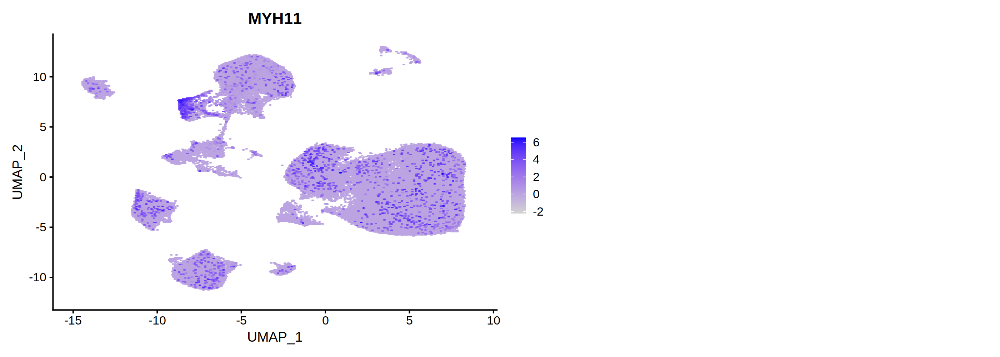

In [105]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("MYH11"),pt.size = pt.size,order = T,ncol=2)

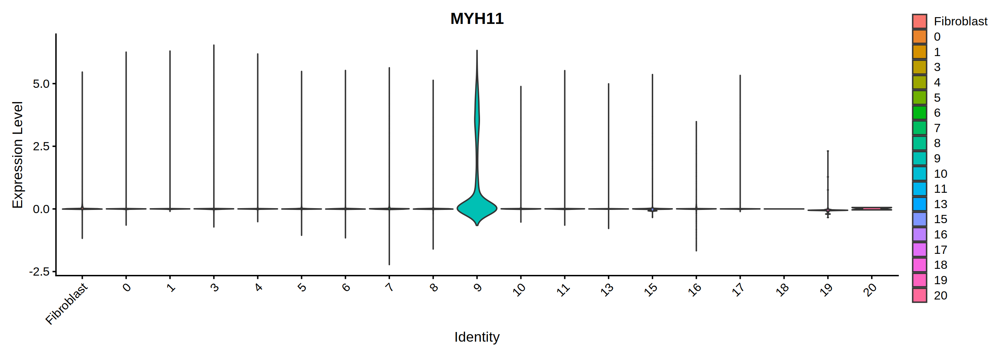

In [106]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)

VlnPlot(dataobj,features = c("MYH11"),pt.size = 0,ncol=1)

In [9]:
dataobj <- RenameIdents(object = dataobj,'9' = 'Smooth muscle cell')

### Pericyte

Warning message:
“Could not find ABCC9 in the default search locations, found in RNA assay instead”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



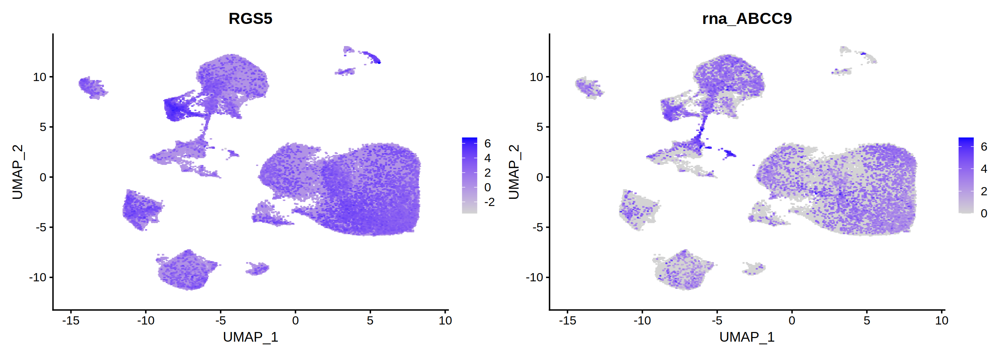

In [108]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("RGS5","ABCC9"),pt.size = pt.size,order = T,ncol=2)

Warning message:
“Could not find ABCC9 in the default search locations, found in RNA assay instead”


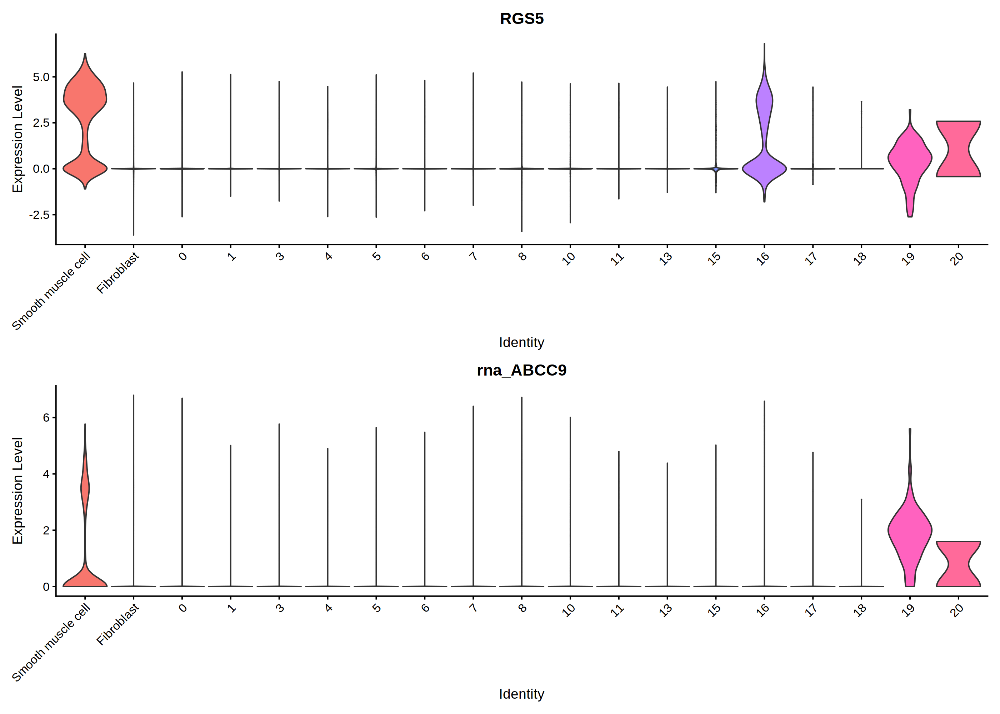

In [109]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("RGS5","ABCC9"),pt.size = 0,ncol=1)

In [8]:
dataobj <- RenameIdents(object = dataobj,'16' = 'Pericyte')

### Mesothelial cell

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



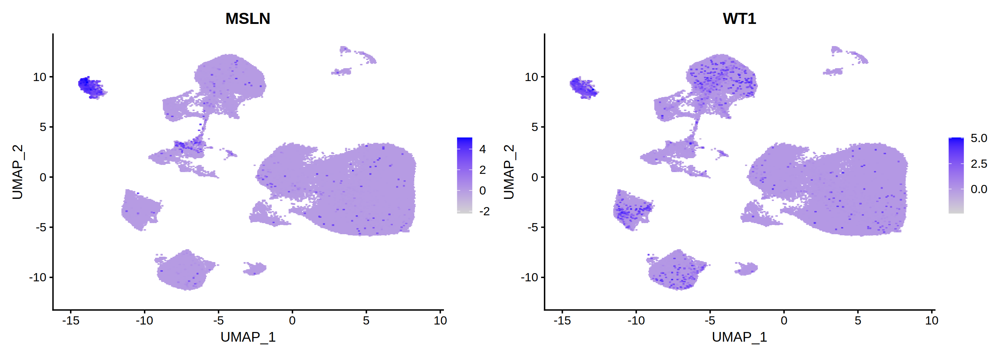

In [111]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("MSLN","WT1"),pt.size = pt.size,order = T,ncol=2)

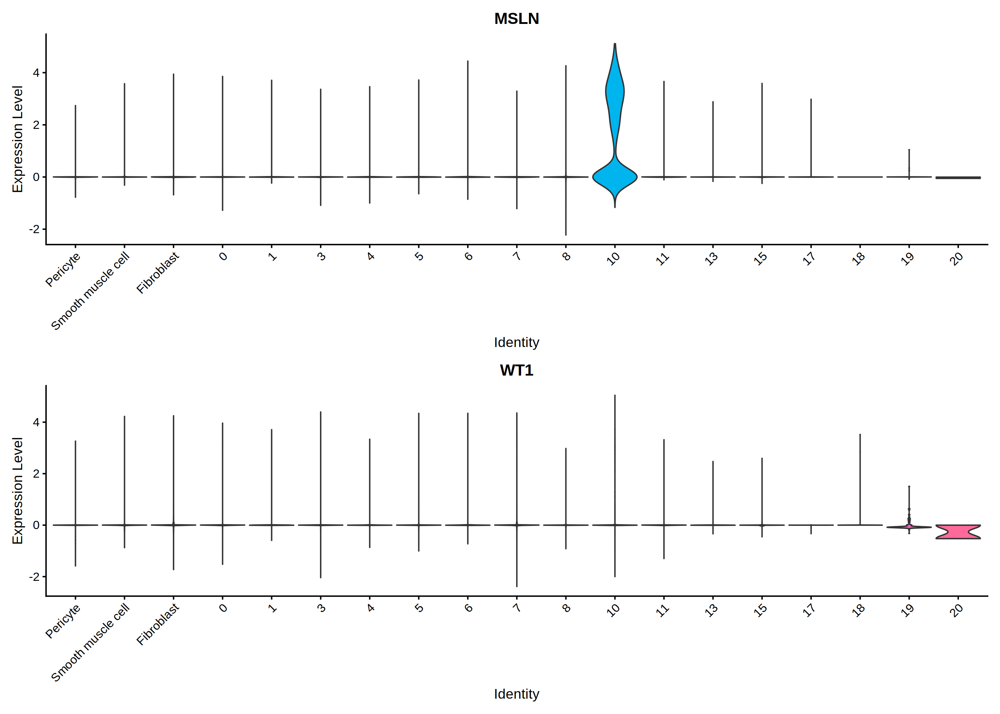

In [112]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("MSLN","WT1"),pt.size = 0,ncol=1)

In [10]:
dataobj <- RenameIdents(object = dataobj,'10' = 'Mesothelial cell')

### Endothelial cell

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



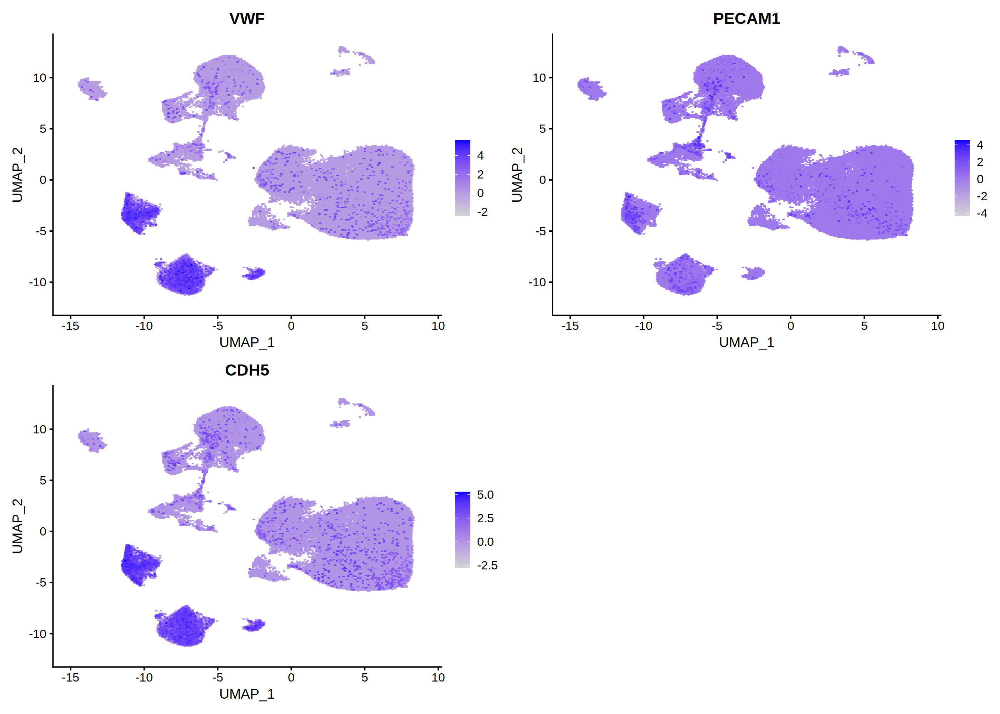

In [114]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("VWF","PECAM1","CDH5"),pt.size = pt.size,order = T,ncol=2)

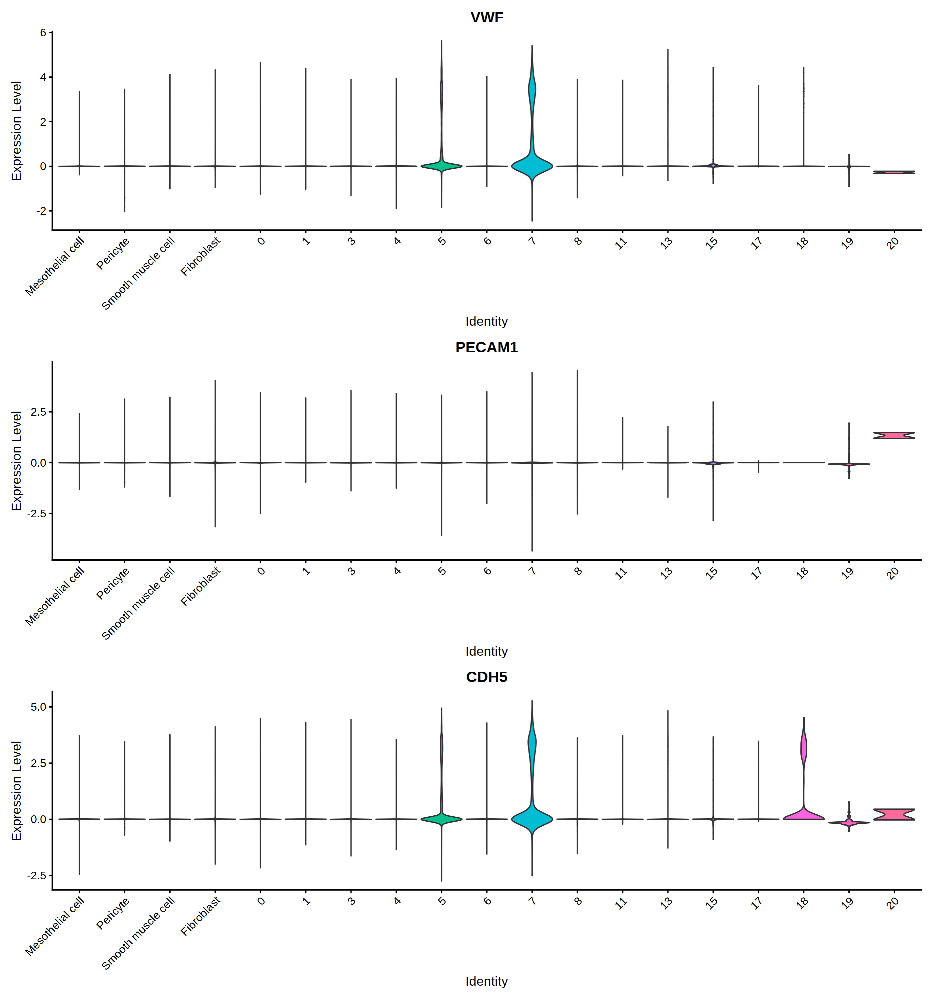

In [115]:
options(repr.plot.width=14, repr.plot.height=5*3, repr.plot.res = 200)

VlnPlot(dataobj,features = c("VWF","PECAM1","CDH5"),pt.size = 0,ncol=1)

In [11]:
dataobj <- RenameIdents(object = dataobj,'5' = 'Endothelial cell','7' = 'Endothelial cell','13' = 'Endothelial cell','18' = 'Endothelial cell')

### Neuron

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



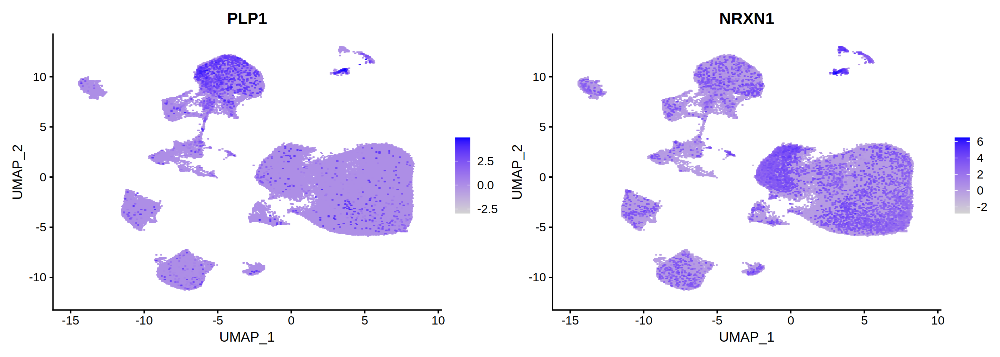

In [117]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("PLP1","NRXN1"),pt.size = pt.size,order = T,ncol=2)

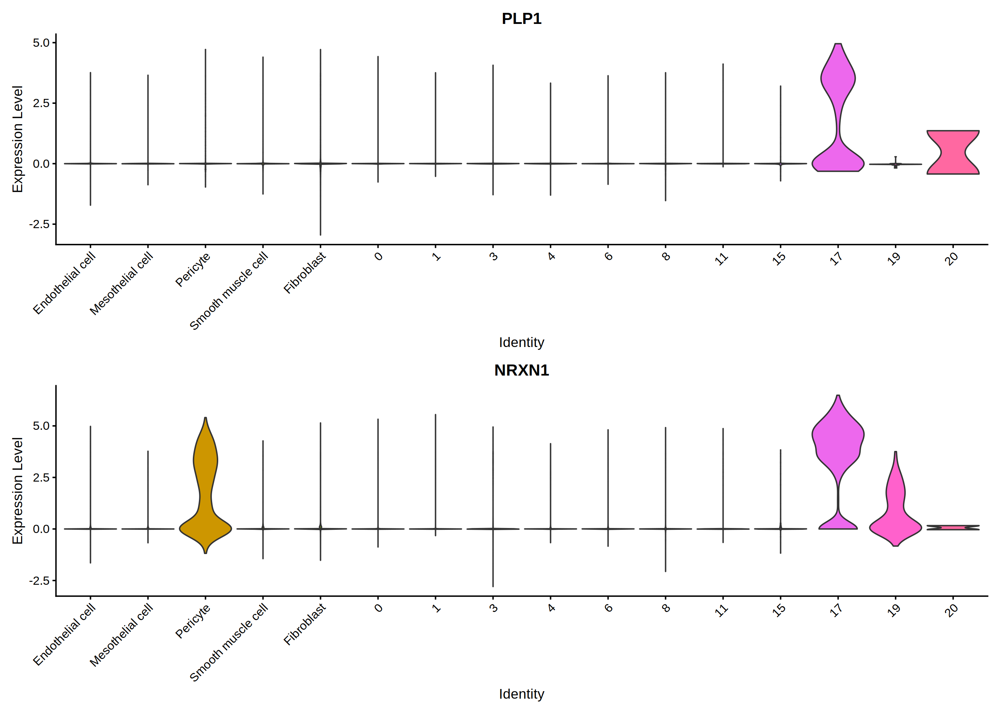

In [118]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("PLP1","NRXN1"),pt.size = 0,ncol=1)

In [12]:
dataobj <- RenameIdents(object = dataobj,'17' = 'Neuron')

### Neurglial cell

Warning message:
“Could not find MBP in the default search locations, found in RNA assay instead”
Warning message:
“Could not find PRX in the default search locations, found in RNA assay instead”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message in FeaturePlot(dataobj, features = c("MBP", "PRX", "MPZ"), pt.size = pt.size, :
“All cells have the same value (0) of rna_MBP.”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Warning message in FeaturePlot(dataobj, features = c("MBP", "PRX", "MPZ"), pt.size = pt.size, :
“All cells have the same value (0) of rna_PRX.”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



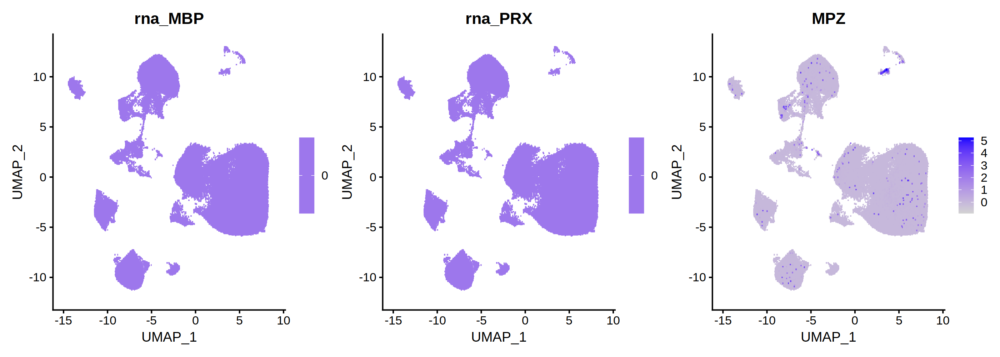

In [120]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("MBP","PRX","MPZ"),pt.size = pt.size,order = T,ncol=3)

Warning message:
“Could not find MBP in the default search locations, found in RNA assay instead”
Warning message:
“Could not find PRX in the default search locations, found in RNA assay instead”
Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of rna_MBP.”
Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of rna_PRX.”


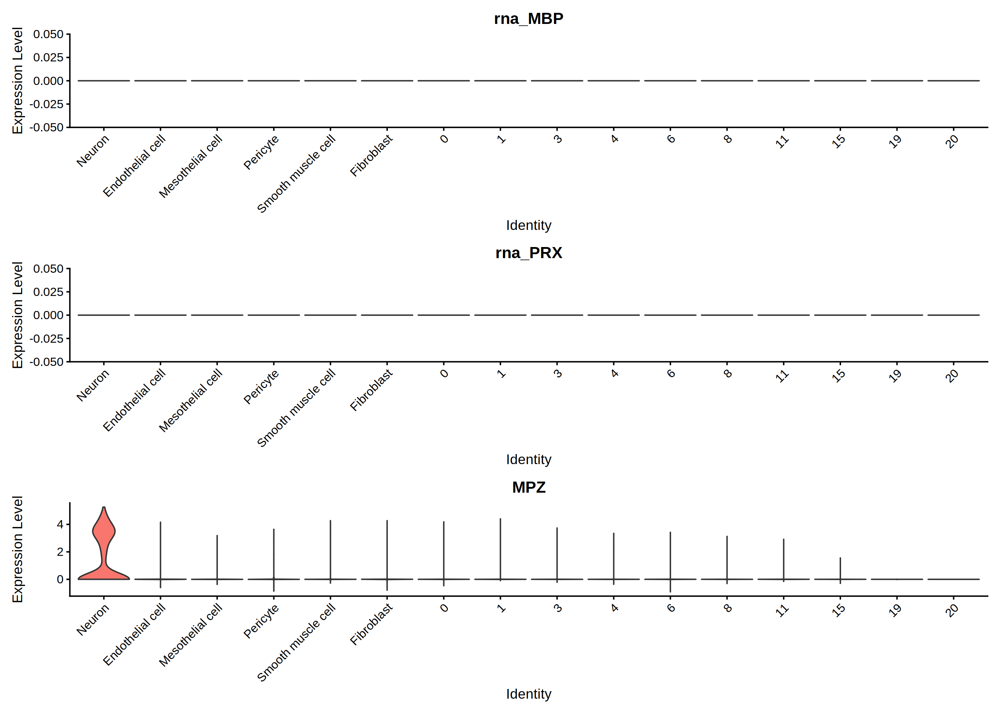

In [121]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("MBP","PRX","MPZ"),pt.size = 0,ncol=1)

### Adipocyte

Warning message:
“Could not find FASN in the default search locations, found in RNA assay instead”
Warning message:
“Could not find GPAM in the default search locations, found in RNA assay instead”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



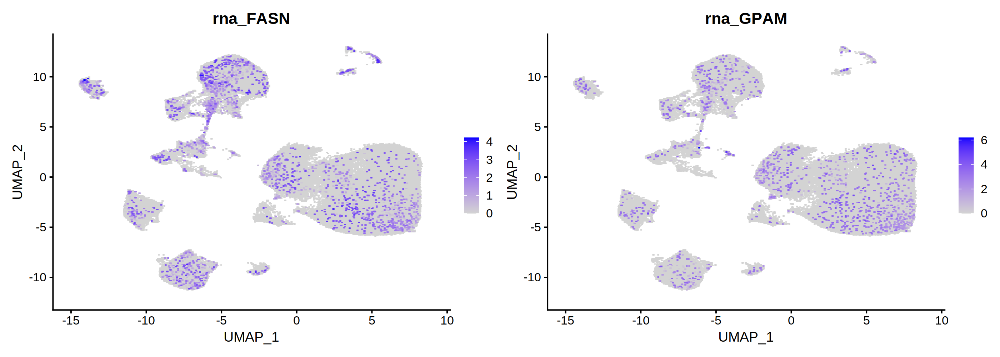

In [122]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("FASN","GPAM"),pt.size = pt.size,order = T,ncol=2)

Warning message:
“Could not find FASN in the default search locations, found in RNA assay instead”
Warning message:
“Could not find GPAM in the default search locations, found in RNA assay instead”


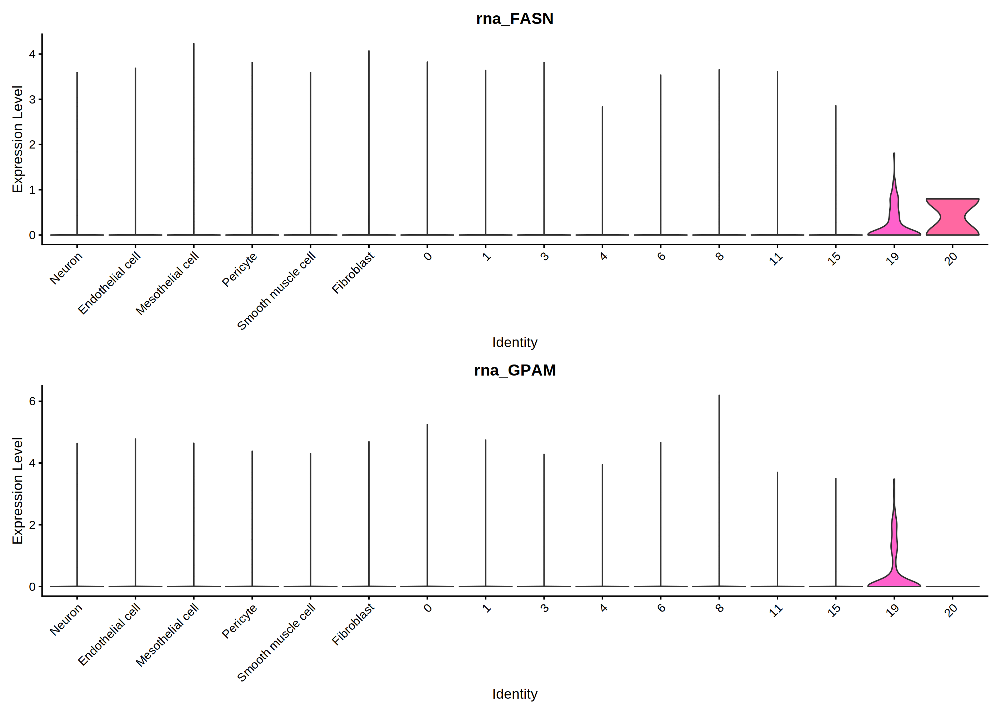

In [123]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("FASN","GPAM"),pt.size = 0,ncol=1)

### Myeloid cell

Warning message:
“Could not find CD68 in the default search locations, found in RNA assay instead”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



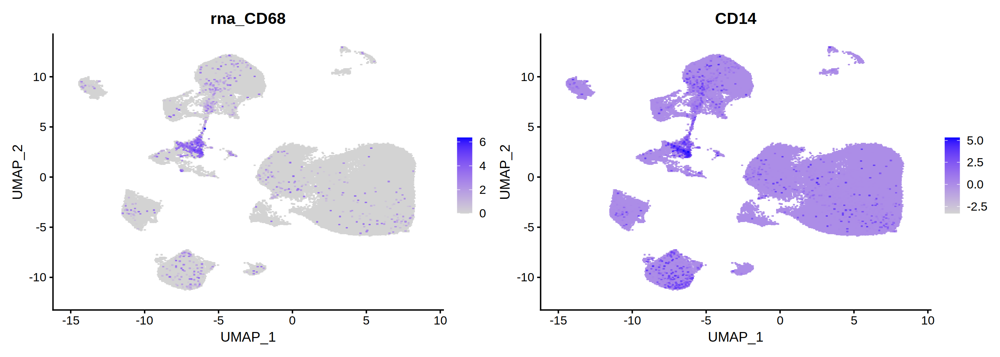

In [124]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("CD68","CD14"),pt.size = pt.size,order = T,ncol=2)

Warning message:
“Could not find CD68 in the default search locations, found in RNA assay instead”


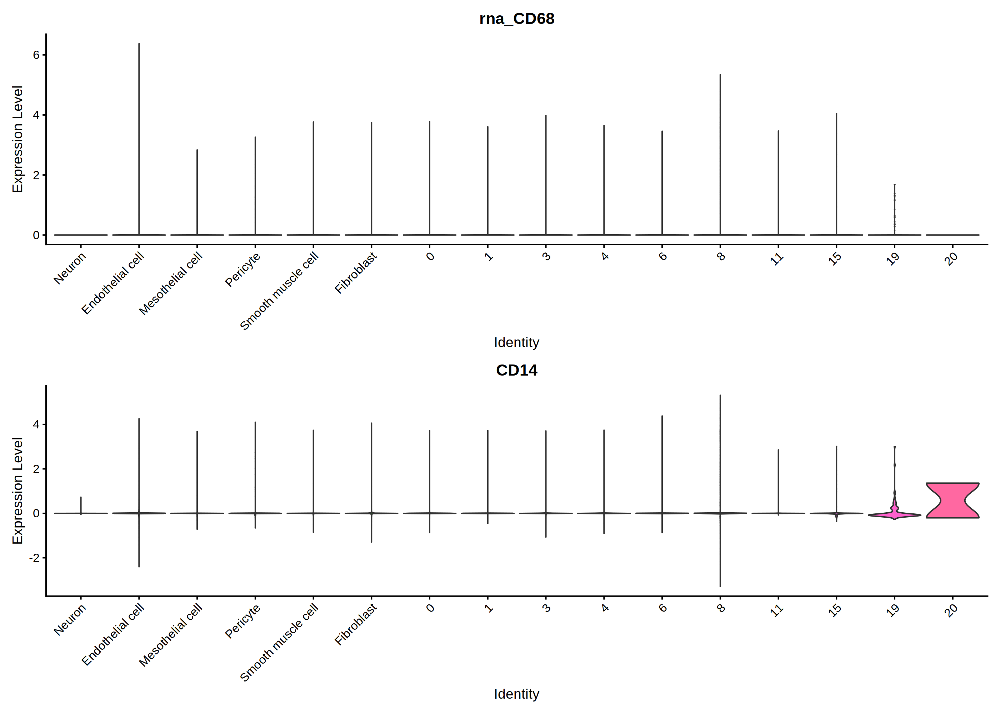

In [125]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("CD68","CD14"),pt.size = 0,ncol=1)

In [13]:
dataobj <- RenameIdents(object = dataobj,'8' = 'Myeloid cell')

### Lymphoid cell

Warning message:
“Could not find CD3E in the default search locations, found in RNA assay instead”
Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



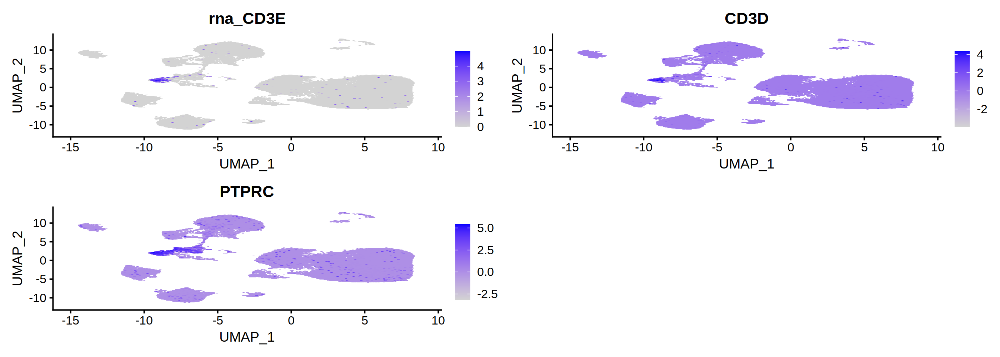

In [127]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(dataobj,features = c("CD3E","CD3D","PTPRC"),pt.size = pt.size,order = T,ncol=2)

Warning message:
“Could not find CD3E in the default search locations, found in RNA assay instead”


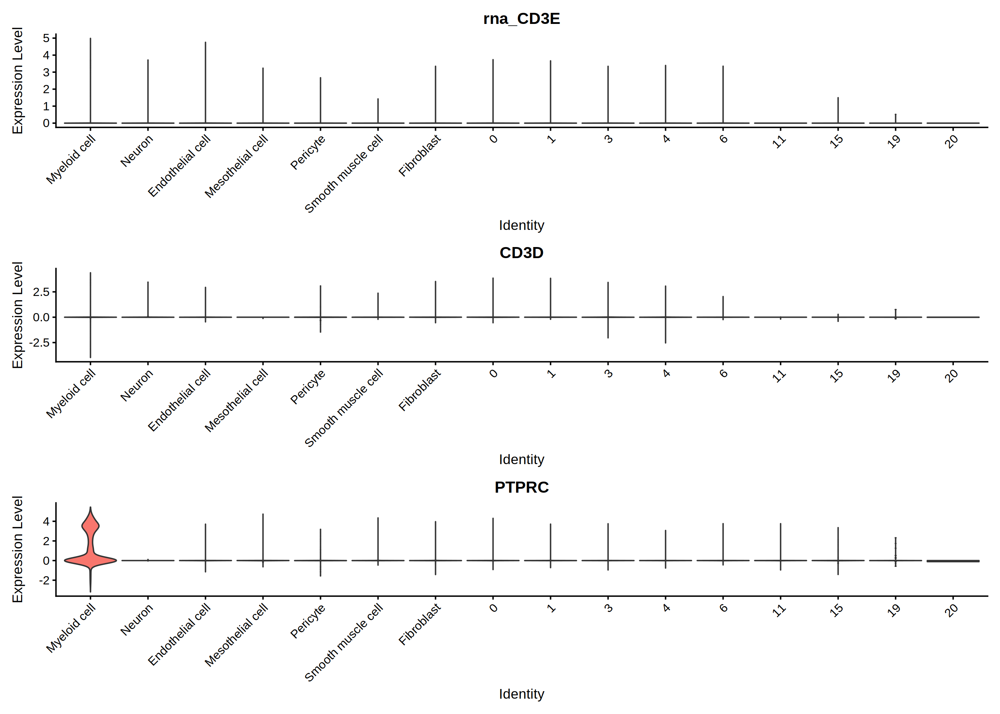

In [128]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("CD3E","CD3D","PTPRC"),pt.size = 0,ncol=1)

In [14]:
dataobj <- RenameIdents(object = dataobj,'15' = 'Lymphoid cell')

### Cardiomyocyte cell

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



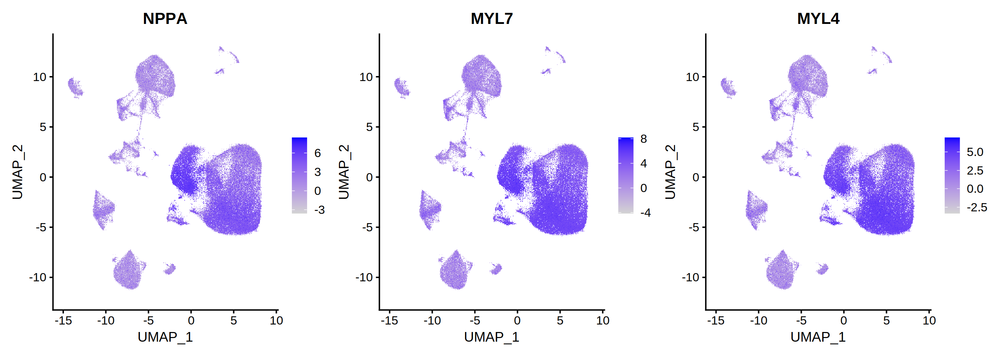

In [130]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)

FeaturePlot(dataobj,features = c("NPPA","MYL7","MYL4"),pt.size = 0.1,order = T,ncol=3)

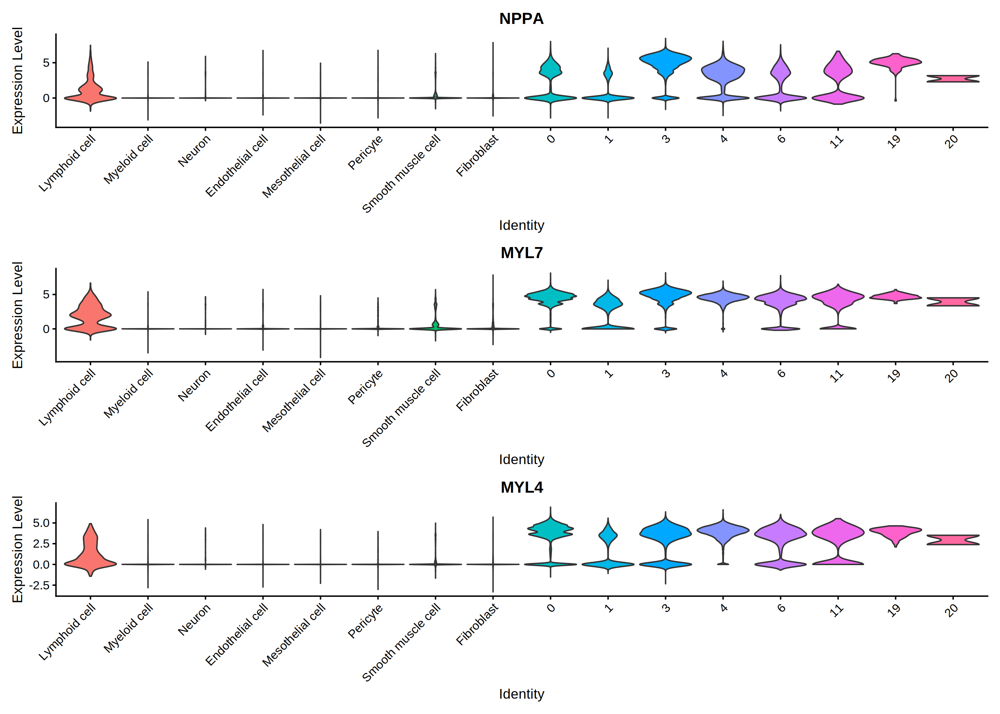

In [131]:
options(repr.plot.width=14, repr.plot.height=10, repr.plot.res = 200)

VlnPlot(dataobj,features = c("NPPA","MYL7","MYL4"),pt.size = 0,ncol=1)

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



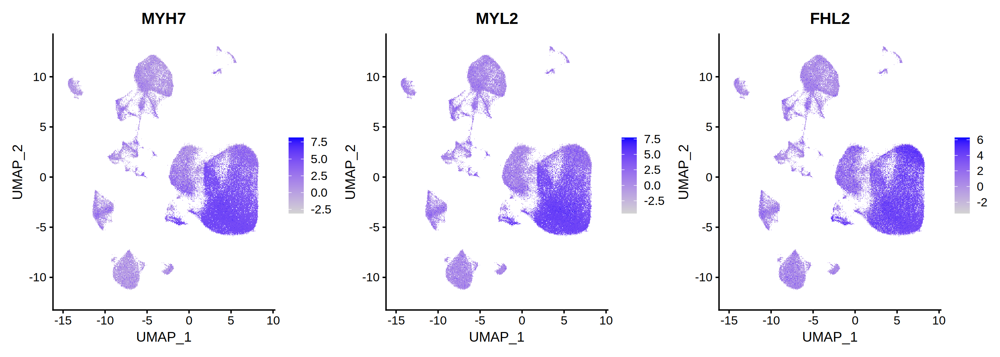

In [132]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)

FeaturePlot(dataobj,features = c("MYH7","MYL2","FHL2"),pt.size = 0.1,order = T,ncol=3)

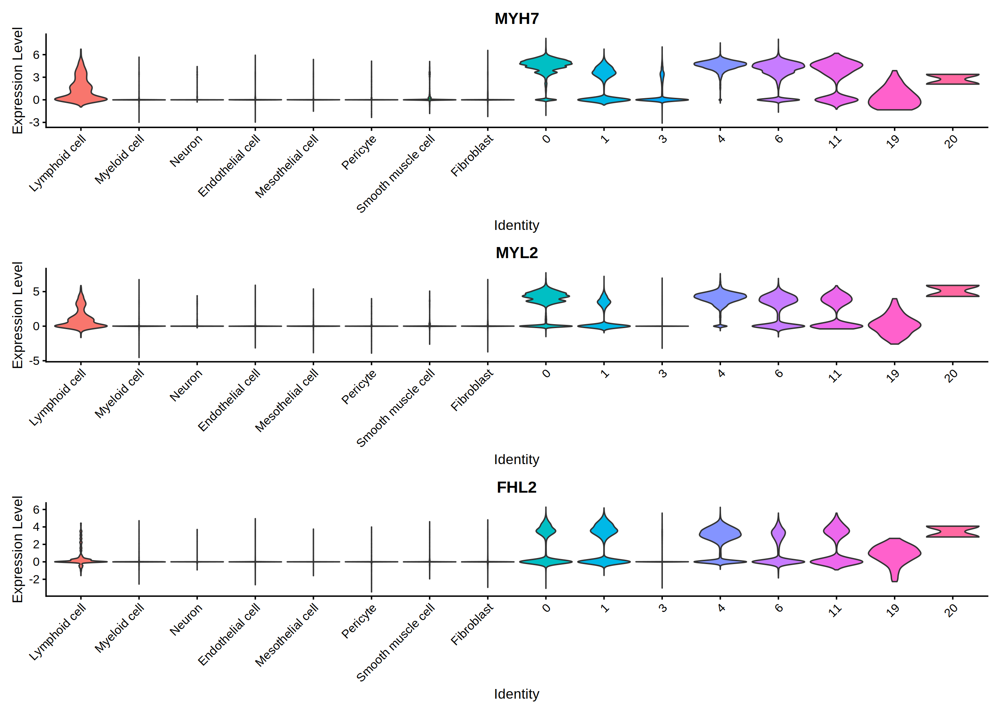

In [133]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(dataobj,features = c("MYH7","MYL2","FHL2"),pt.size = 0,ncol=1)

In [15]:
dataobj <- RenameIdents(object = dataobj,'0' = 'Cardiomyocyte cell','1' = 'Cardiomyocyte cell','3' = 'Cardiomyocyte cell','4' = 'Cardiomyocyte cell','6' = 'Cardiomyocyte cell','11' = 'Cardiomyocyte cell','19' = 'Cardiomyocyte cell','20' = 'Cardiomyocyte cell')

In [16]:
dataobj$cell_type <- as.character(Idents(dataobj))
dataobj$cell_type[dataobj$cell_type %in% c("Lymphoid cell", "Myeloid cell")] <- "Immune cell"

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



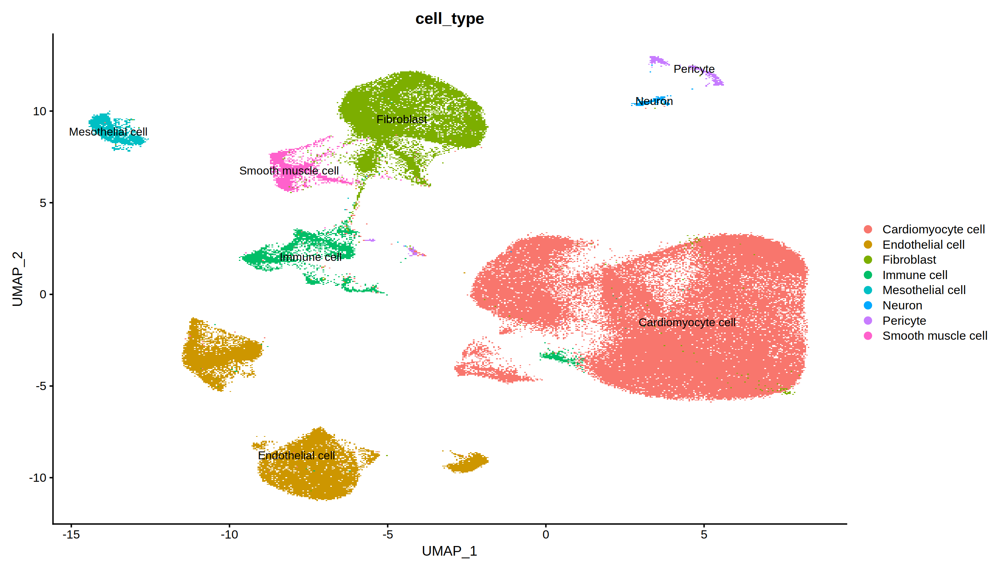

In [17]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(dataobj,reduction = "umap",label = T,group.by = "cell_type")

### Reannotate Endothelial cell

In [18]:
subobj <- subset(dataobj,cell_type =="Endothelial cell")

In [19]:
subobj

An object of class Seurat 
45878 features across 16480 samples within 2 assays 
Active assay: integrated (2000 features, 2000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, tsne

In [20]:
subobj <- FindVariableFeatures(subobj) # default feature number, nfeatures = 2000
subobj <- ScaleData(subobj, features = VariableFeatures(subobj))

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
“selection.method set to 'vst' but count slot is empty; will use data slot instead”
Warning message in eval(predvars, data, env):
“NaNs produced”
Warning message in hvf.info$variance.expected[not.const] <- 10^fit$fitted:
“number of items to replace is not a multiple of replacement length”
Centering and scaling data matrix



PC_ 1 
Positive:  IGF2, H19, IGFBP7, COL15A1, A2M, COL4A1, DACH1, COL4A2, CD36, ARL15 
	   PLCB1, SLC9C1, DIPK2B, APLNR, CDH13, PCDH17, TNNT3, MALAT1, FRMD4A, CLDN5 
	   MEOX2, ADGRL4, MXRA5, CAV1, ARHGAP18, PTPRB, TM4SF18, PRND, VAV3, NAV1 
Negative:  COL3A1, POSTN, CDH11, COL1A2, FN1, HMCN1, LEPR, FOXC1, TGM2, SMIM6 
	   PCDH7, VCAN, INHBA, FBLN2, CCDC80, CGNL1, ENG, ITGA8, CLU, ADGRG6 
	   APCDD1, ITM2B, ECE1, VIM, CALCRL, TIMP1, CD9, SPARCL1, SMOC1, TFPI 
PC_ 2 
Positive:  H19, IGF2, SPARC, COL4A1, TUBA1B, COL4A2, CALM1, CD93, COL15A1, SPARCL1 
	   MKI67, TOP2A, ACTB, LGALS1, ACTG1, A2M, CENPF, CAV1, CENPE, TMSB10 
	   APLNR, VIM, ASPM, CD34, IL32, TMSB4X, HSPG2, NUSAP1, IGFBP3, NES 
Negative:  CCL21, STAB2, RELN, LYVE1, EFNA5, NRG3, STON2, TSHZ2, PTPRE, NTS 
	   GPM6A, MMRN1, MALAT1, SNTG2, TFF3, IL7, SLC9A9, FLRT2, NEAT1, PCLO 
	   IGF1, SEMA3A, DOCK8, TFPI, NR2F1, FAM155A, PDE1A, SEMA3D, PKHD1L1, VAV3 
PC_ 3 
Positive:  MECOM, DACH1, SLC9C1, EMCN, CARD17, HTR2A-AS1, OR51I1, PLCB

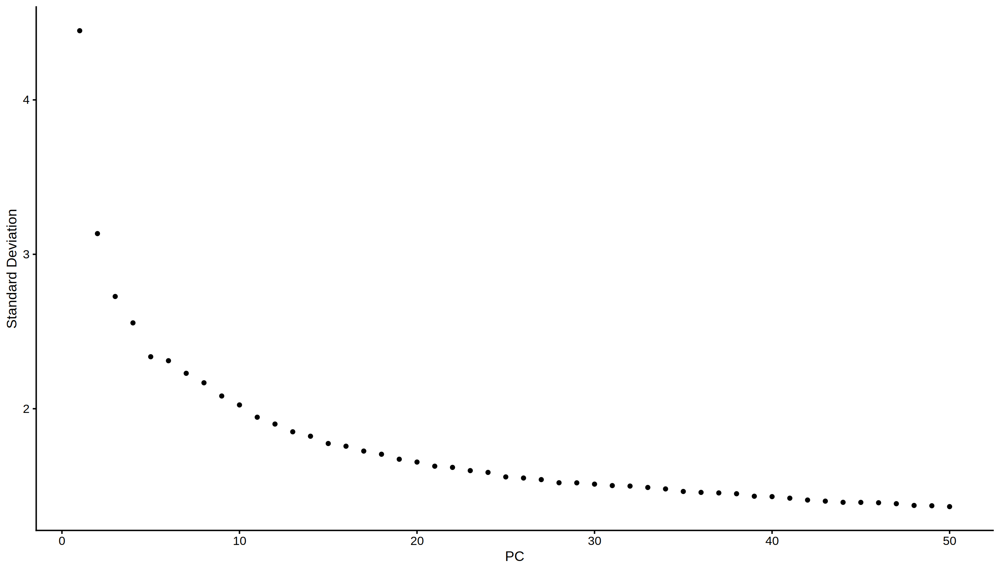

In [21]:
subobj <- RunPCA(subobj, features = VariableFeatures(object = subobj))
ElbowPlot(subobj,ndims=50) 

In [22]:
pcDim = 30

In [23]:
subobj <- RunUMAP(subobj, dims = 1:pcDim)

Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”
23:14:58 UMAP embedding parameters a = 0.9922 b = 1.112

23:14:59 Read 16480 rows and found 30 numeric columns

23:14:59 Using Annoy for neighbor search, n_neighbors = 30

23:14:59 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

23:15:00 Writing NN index file to temp file /tmp/RtmpVfqaYf/file21bcdb40a89b89

23:15:00 Searching Annoy index using 1 thread, search_k = 3000

23:15:04 Annoy recall = 100%

23:15:05 Commencing smooth kNN distance calibration using 1 thread

23:15:06 Initializing 

In [24]:
# Cluster the cells
subobj <- FindNeighbors(subobj, reduction = "pca", dims = 1:pcDim, nn.eps = 0.5)
subobj <- FindClusters(subobj, resolution = 0.3, n.start = 2)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 16480
Number of edges: 612020

Running Louvain algorithm...
Maximum modularity in 2 random starts: 0.8918
Number of communities: 8
Elapsed time: 0 seconds


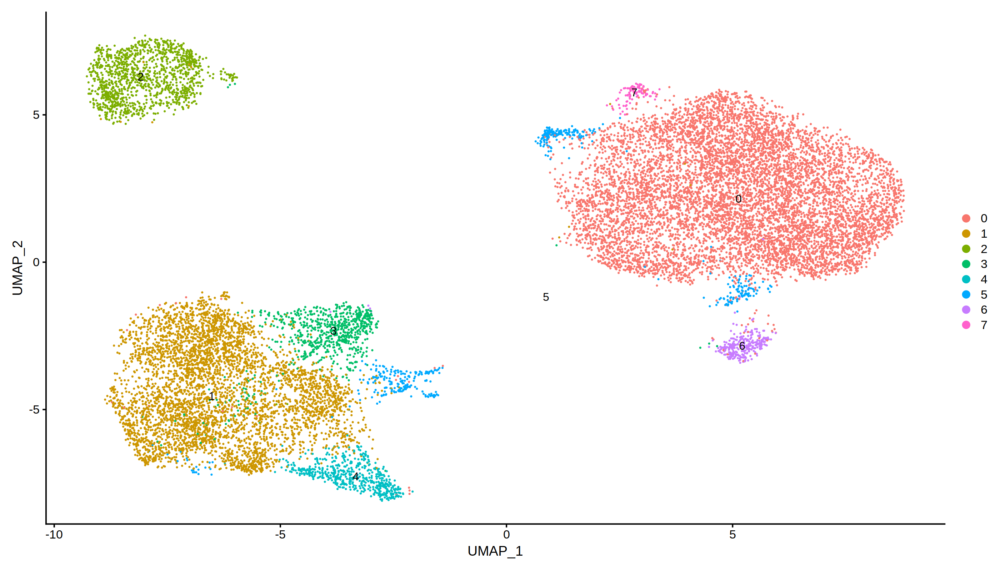

In [25]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

#### Vascular endothelial cell

Warning message:
“Could not find SEMA3G in the default search locations, found in RNA assay instead”
Warning message:
“Could not find EFNB2 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find DLL4 in the default search locations, found in RNA assay instead”


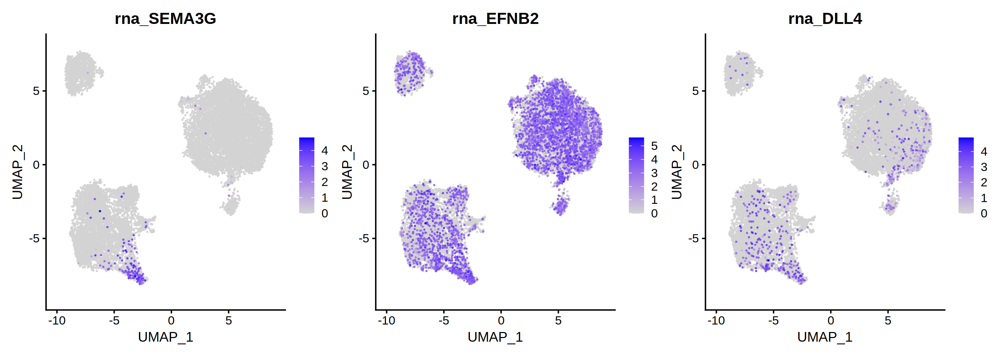

In [34]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=0.1

FeaturePlot(subobj,features = c("SEMA3G","EFNB2","DLL4"),pt.size = pt.size,order = T,ncol=3)

Warning message:
“Could not find SEMA3G in the default search locations, found in RNA assay instead”
Warning message:
“Could not find EFNB2 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find DLL4 in the default search locations, found in RNA assay instead”


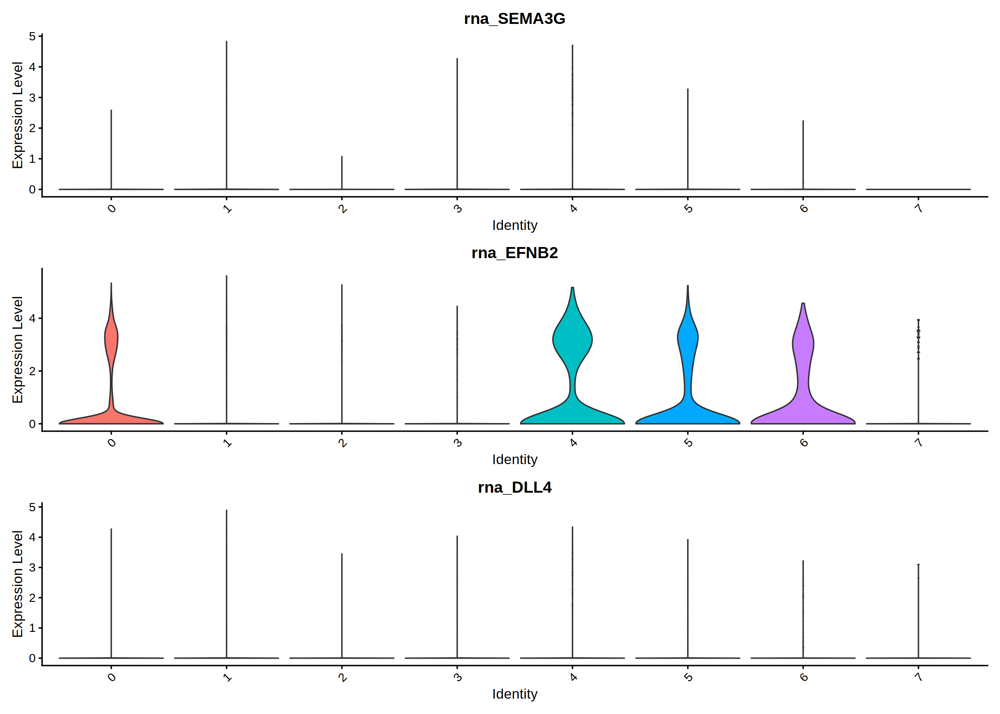

In [35]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(subobj,features = c("SEMA3G","EFNB2","DLL4"),pt.size = 0,ncol=1)

Warning message:
“Could not find NR2F2 in the default search locations, found in RNA assay instead”


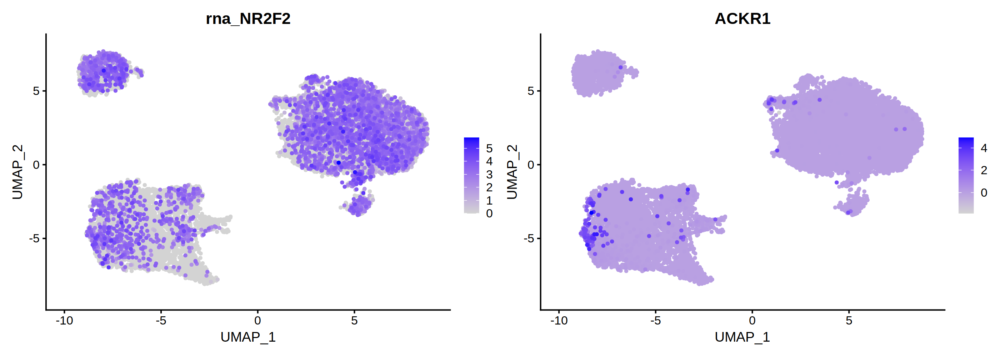

In [36]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(subobj,features = c("NR2F2","ACKR1"),pt.size = pt.size,order = T,ncol=2)

Warning message:
“Could not find NR2F2 in the default search locations, found in RNA assay instead”


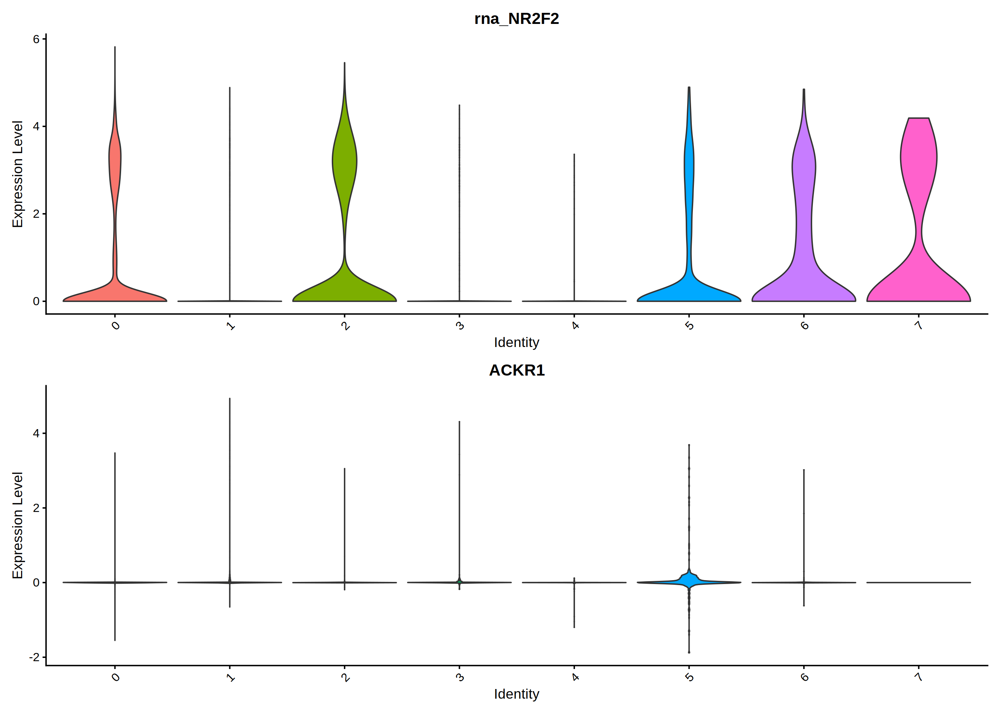

In [37]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(subobj,features = c("NR2F2","ACKR1"),pt.size = 0,ncol=1)

In [26]:
subobj <- RenameIdents(object = subobj,'0' = 'Vascular endothelial cell','1' = 'Vascular endothelial cell','3' = 'Vascular endothelial cell','4' = 'Vascular endothelial cell','5' = 'Vascular endothelial cell','6' = 'Vascular endothelial cell','7' = 'Vascular endothelial cell')

#### Endocardial cell

Warning message:
“Could not find NPR3 in the default search locations, found in RNA assay instead”
Warning message in FeaturePlot(subobj, features = c("NPR3"), pt.size = pt.size, :
“All cells have the same value (0) of rna_NPR3.”


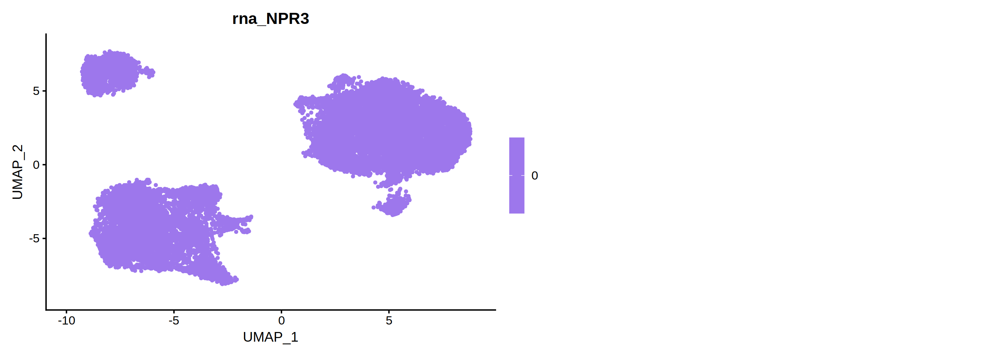

In [38]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(subobj,features = c("NPR3"),pt.size = pt.size,order = T,ncol=2)

#### Lymphatic endothelial cell

Warning message:
“Could not find PROX1 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find TBX1 in the default search locations, found in RNA assay instead”


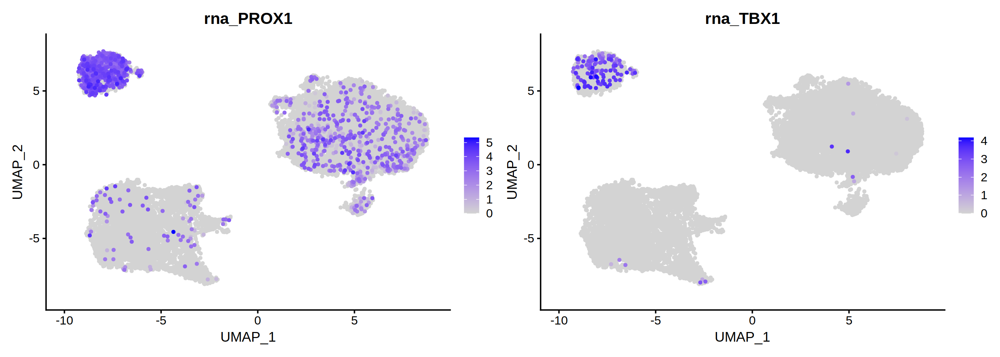

In [39]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(subobj,features = c("PROX1","TBX1"),pt.size = pt.size,order = T,ncol=2)

Warning message:
“Could not find PROX1 in the default search locations, found in RNA assay instead”
Warning message:
“Could not find TBX1 in the default search locations, found in RNA assay instead”


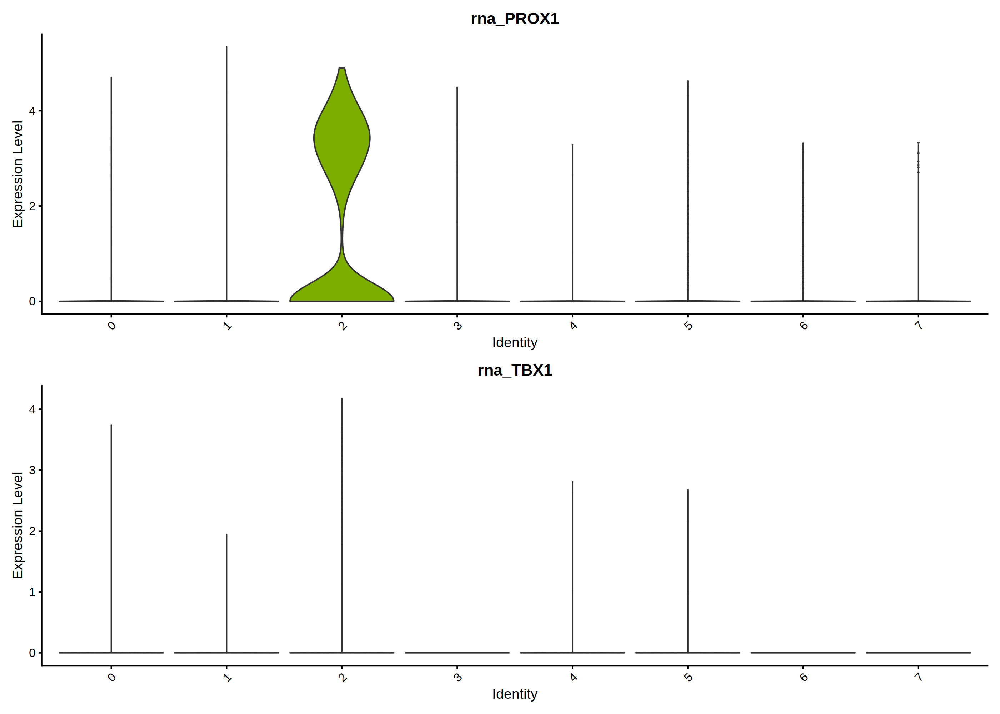

In [40]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(subobj,features = c("PROX1","TBX1"),pt.size = 0,ncol=1)

In [27]:
subobj <- RenameIdents(object = subobj,'2' = 'Lymphatic endothelial cell')

#### Capillary endothelial cell

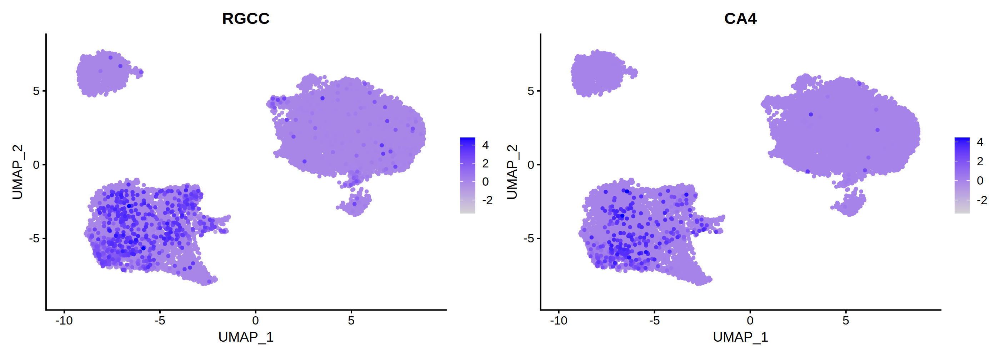

In [42]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
pt.size=1


FeaturePlot(subobj,features = c("RGCC","CA4"),pt.size = pt.size,order = T,ncol=2)

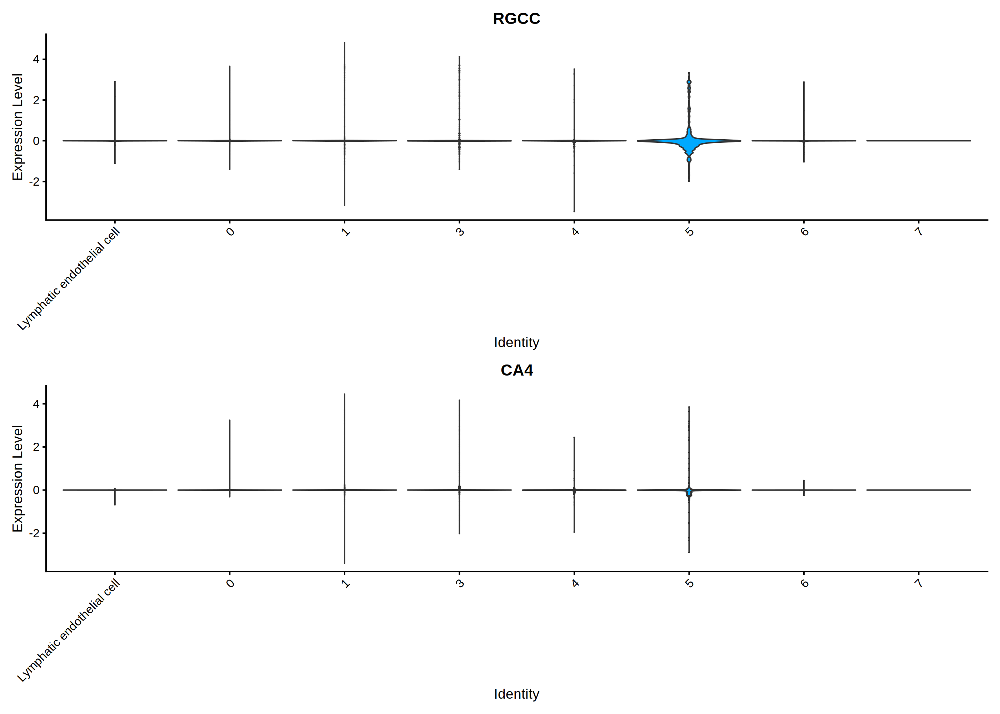

In [43]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
VlnPlot(subobj,features = c("RGCC","CA4"),pt.size = 0,ncol=1)

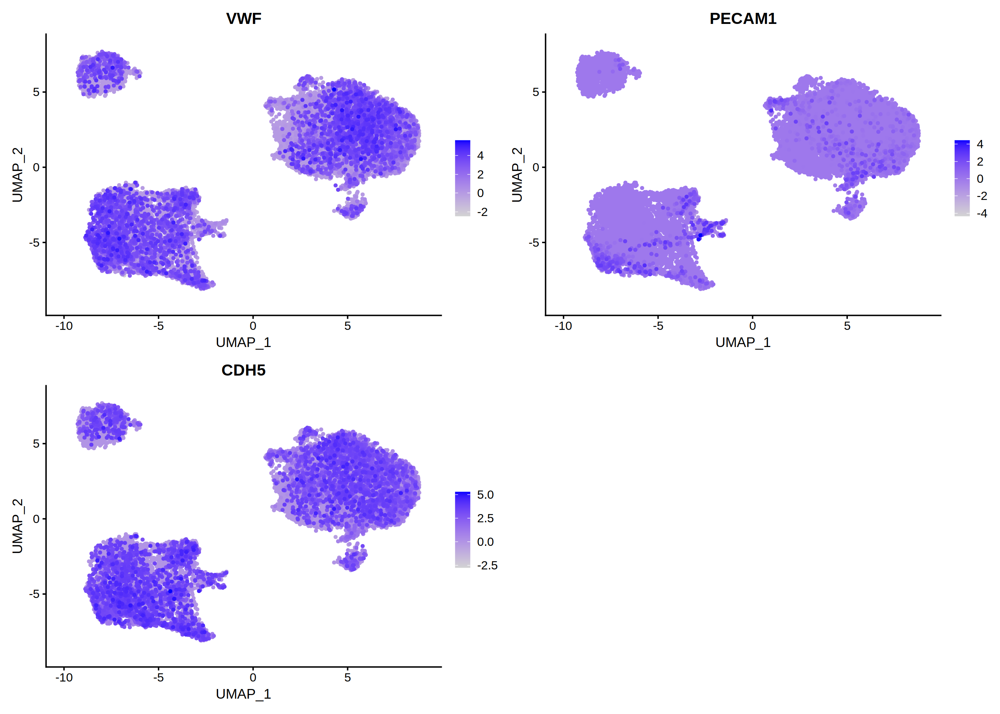

In [45]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
pt.size=1


FeaturePlot(subobj,features = c("VWF","PECAM1","CDH5"),pt.size = pt.size,order = T,ncol=2)

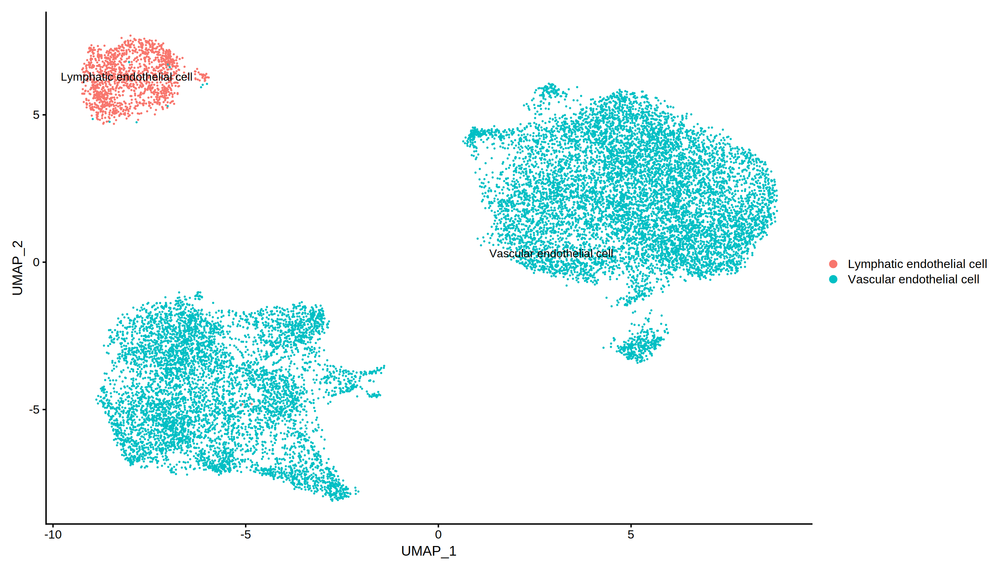

In [28]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

In [29]:
# save the subtypes
dataobj$sub.cell_type <- dataobj$cell_type
dataobj$sub.cell_type[colnames(dataobj) %in% colnames(subobj)] <- as.character(Idents(subobj))

### Reannotate Fibroblast

In [30]:
subobj <- subset(dataobj,cell_type =="Fibroblast")

In [31]:
subobj <- FindVariableFeatures(subobj) # default feature number, nfeatures = 2000
subobj <- ScaleData(subobj, features = VariableFeatures(subobj))

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
“selection.method set to 'vst' but count slot is empty; will use data slot instead”
Warning message in eval(predvars, data, env):
“NaNs produced”
Warning message in hvf.info$variance.expected[not.const] <- 10^fit$fitted:
“number of items to replace is not a multiple of replacement length”
Centering and scaling data matrix



PC_ 1 
Positive:  TTN, SORBS2, MYH7, TNNI3, MYL7, MYL4, LDB3, TNNI1, ACTC1, MALAT1 
	   TNNT2, SLC8A1, FGF12, TPM1, RYR2, MYL3, PDLIM5, CKM, MYL2, TOP2A 
	   MKI67, ASPM, ACTN2, CENPF, MYOM1, FHOD3, KNL1, MTUS2, NEBL, MYBPC3 
Negative:  COL1A1, COL3A1, COL1A2, DCN, IGF2, SPARC, COL6A2, H19, COL5A1, LUM 
	   OGN, MMP2, FBN1, DLK1, COL6A1, FBLN1, FSTL1, FN1, COL5A2, LTBP4 
	   POSTN, SMIM6, ASPN, ISLR, PCOLCE, OLFML3, SEMA3C, MXRA5, KCTD12, SPARCL1 
PC_ 2 
Positive:  TUBA1B, MKI67, TOP2A, VIM, H19, CENPF, ASPM, COL3A1, CENPE, COL6A2 
	   GAPDH, LGALS1, TPX2, PRC1, COL1A1, TMSB10, SMC4, ANLN, KNL1, NUSAP1 
	   ARL6IP1, COL6A1, COL1A2, STMN1, SPARC, UBE2C, IGF2, COL5A1, FN1, ACTG1 
Negative:  MALAT1, RBMS3, GPC6, ZNF385D, NAALADL2, ADAMTS19, CNTNAP2, EGFEM1P, NEGR1, KCNQ1OT1 
	   TBX20, EBF2, ADGRB3, MEG3, PLCB1, UNC5C, ARL15, MGAT4C, BICC1, NCKAP5 
	   BNC2, CCDC102B, LSAMP, TSHZ2, ABCA10, NCAM2, DCC, PID1, PCDH9, CNTN5 
PC_ 3 
Positive:  FOS, SPARC, SFRP1, RRAD, IGFBP5, PPP1R15A, SLN, NR

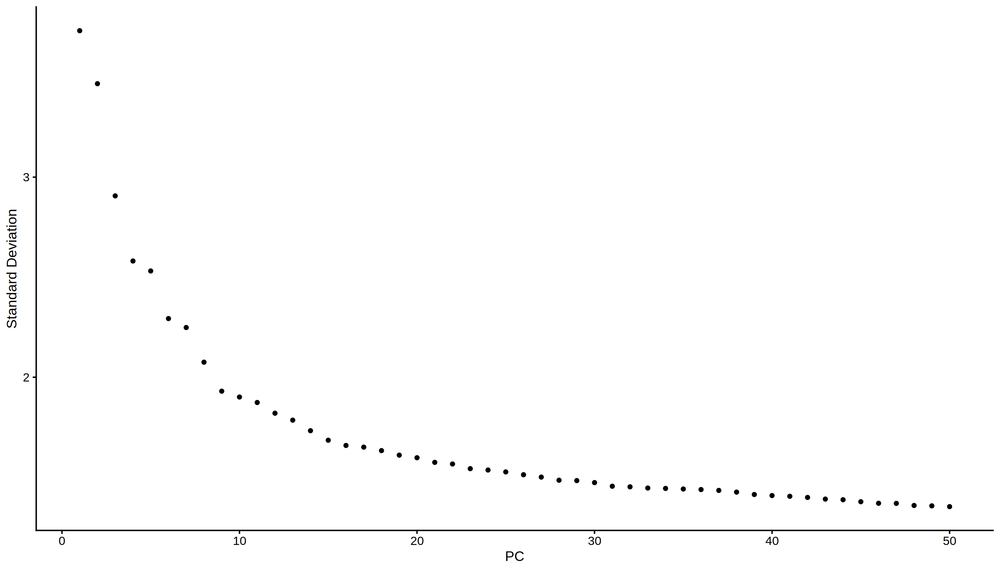

In [32]:
subobj <- RunPCA(subobj, features = VariableFeatures(object = subobj))
ElbowPlot(subobj,ndims=50) 

In [33]:
pcDim = 30

In [34]:
subobj <- RunUMAP(subobj, dims = 1:pcDim)
p_umap <- DimPlot(subobj, reduction = "umap", label = TRUE, pt.size=1)

23:16:10 UMAP embedding parameters a = 0.9922 b = 1.112

23:16:10 Read 17377 rows and found 30 numeric columns

23:16:10 Using Annoy for neighbor search, n_neighbors = 30

23:16:10 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

23:16:11 Writing NN index file to temp file /tmp/RtmpVfqaYf/file21bcdb2b8c98ac

23:16:11 Searching Annoy index using 1 thread, search_k = 3000

23:16:16 Annoy recall = 100%

23:16:17 Commencing smooth kNN distance calibration using 1 thread

23:16:17 Initializing from normalized Laplacian + noise

23:16:18 Commencing optimization for 200 epochs, with 801368 positive edges

23:16:25 Optimization finished



In [35]:
# Cluster the cells
subobj <- FindNeighbors(subobj, reduction = "pca", dims = 1:pcDim, nn.eps = 0.5)
subobj <- FindClusters(subobj, resolution = 0.15, n.start = 3)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 17377
Number of edges: 603652

Running Louvain algorithm...
Maximum modularity in 3 random starts: 0.9154
Number of communities: 5
Elapsed time: 0 seconds


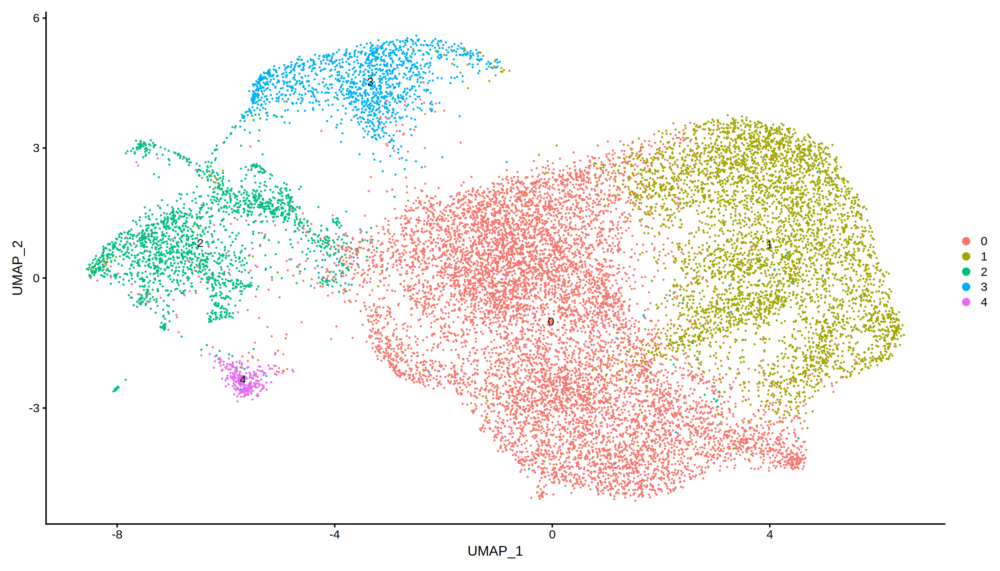

In [55]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

#### Myofibroblast

Warning message:
“Could not find ADAM12 in the default search locations, found in RNA assay instead”


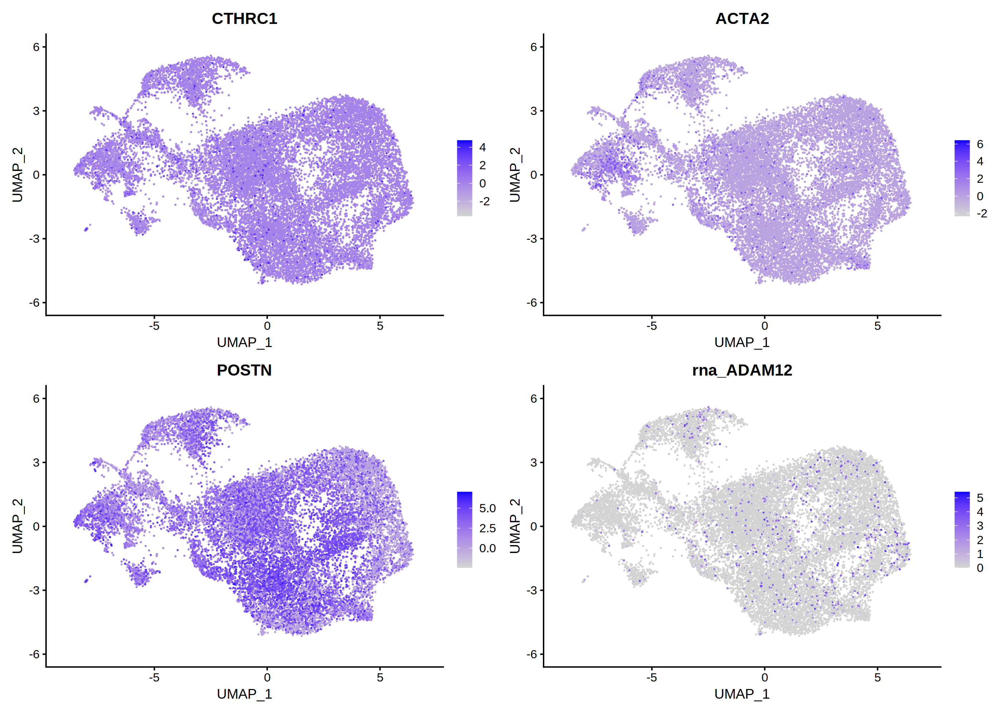

In [56]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("CTHRC1","ACTA2","POSTN","ADAM12"))


Warning message:
“Could not find ADAM12 in the default search locations, found in RNA assay instead”


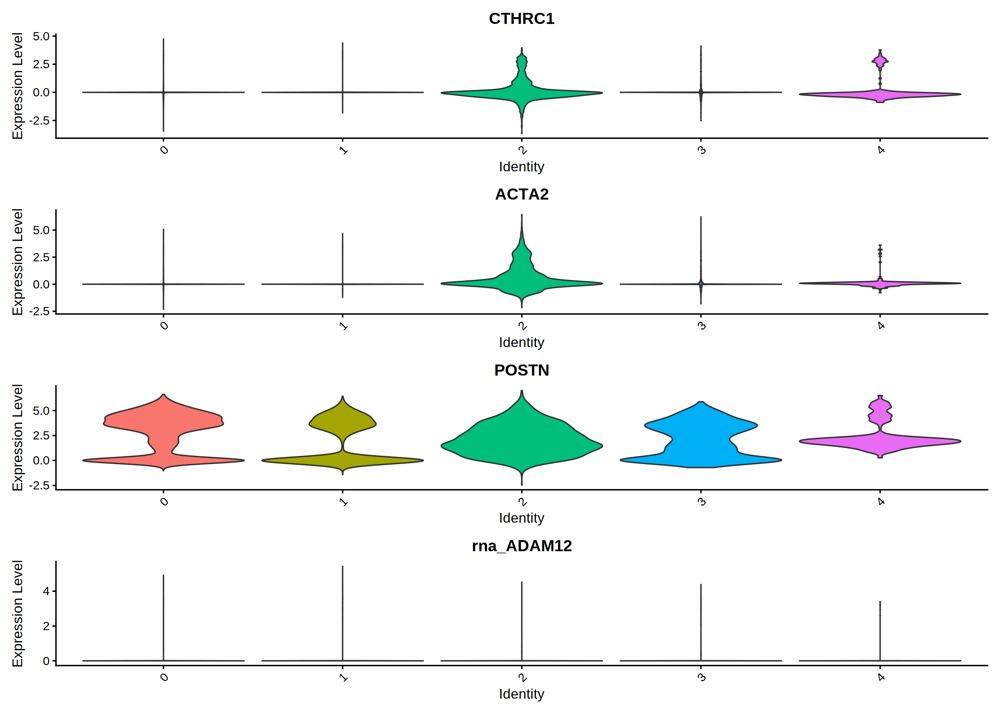

In [60]:
VlnPlot(subobj,features = c("CTHRC1","ACTA2","POSTN","ADAM12"),pt.size = 0,ncol=1)

In [36]:
subobj <- RenameIdents(object = subobj,'2' = 'Myofibroblast')

#### Fibrocyte

Warning message:
“Could not find CCR2 in the default search locations, found in RNA assay instead”


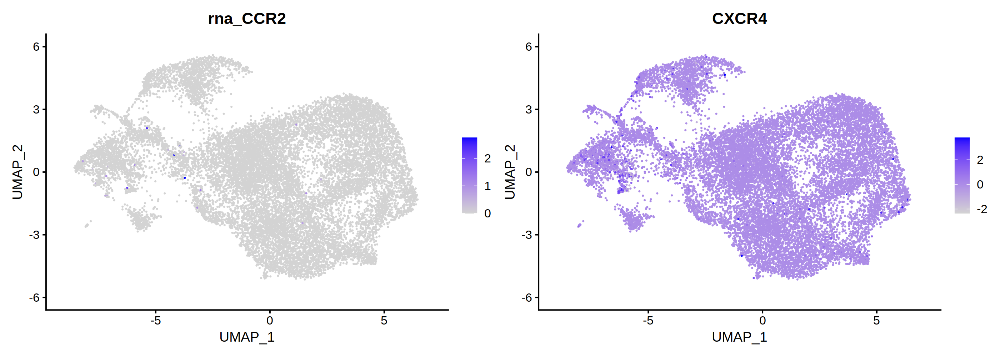

In [57]:
options(repr.plot.width=14, repr.plot.height=5*1, repr.plot.res = 200)
FeaturePlot(subobj,c("CCR2","CXCR4"))


Warning message:
“Could not find CCR2 in the default search locations, found in RNA assay instead”


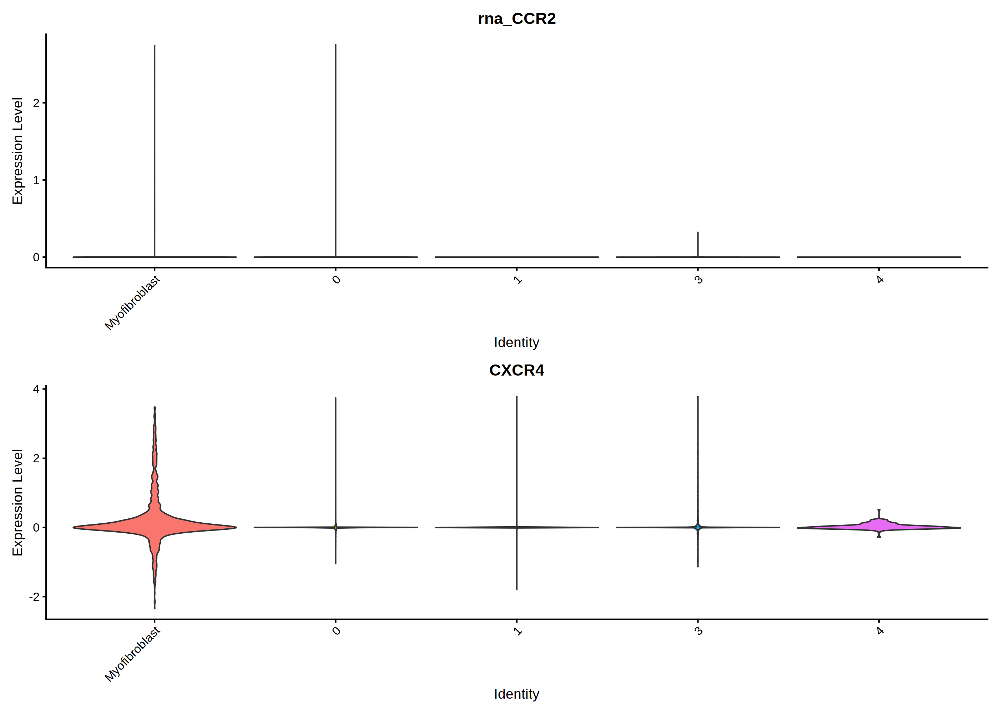

In [62]:
VlnPlot(subobj,features = c("CCR2","CXCR4"),pt.size = 0,ncol=1)

#### Basement membrane fibroblast

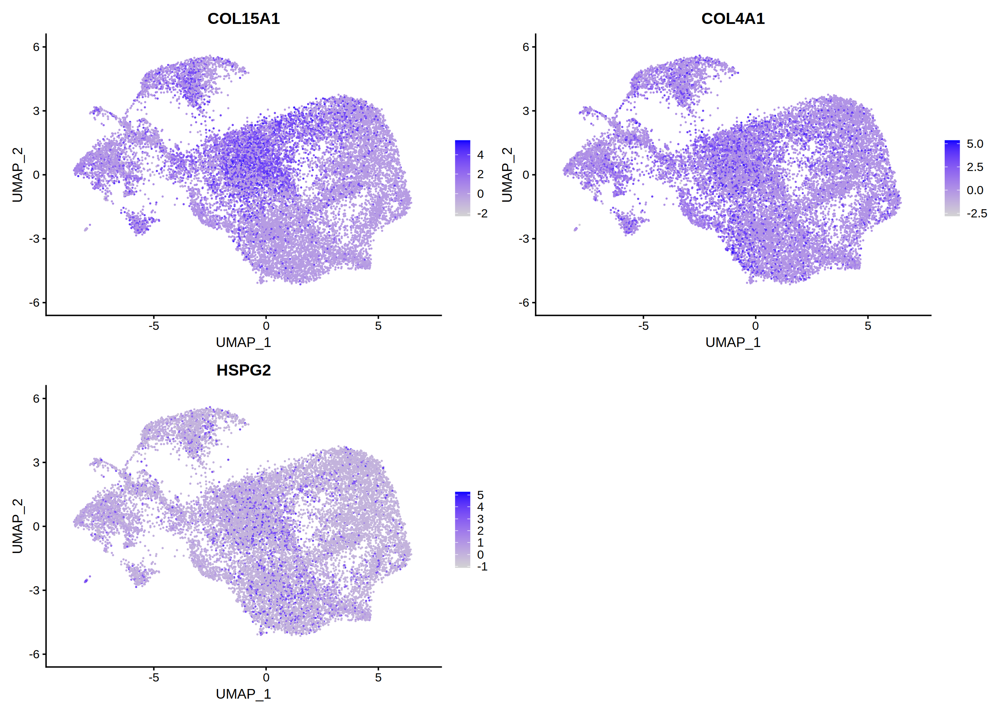

In [58]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("COL15A1","COL4A1","HSPG2"))


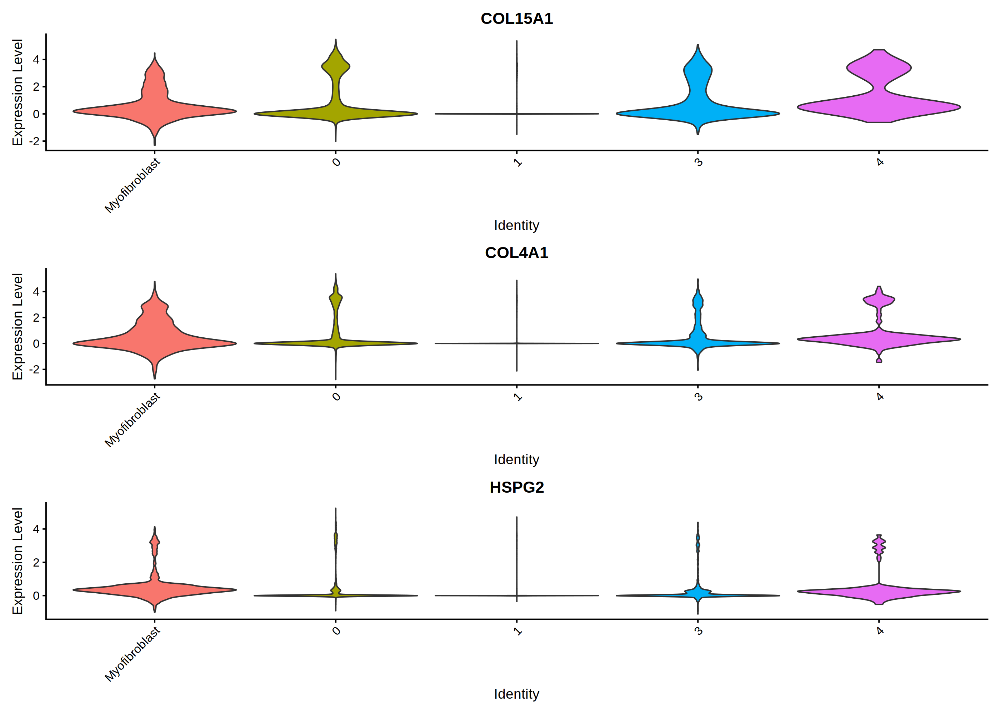

In [63]:
VlnPlot(subobj,features = c("COL15A1","COL4A1","HSPG2"),pt.size = 0,ncol=1)

In [37]:
subobj <- RenameIdents(object = subobj,'0' = 'Basement membrane fibroblast','1' = 'Basement membrane fibroblast','3' = 'Basement membrane fibroblast','4' = 'Basement membrane fibroblast')

#### Adventitial fibroblast

Warning message:
“Could not find DPP4 in the default search locations, found in RNA assay instead”


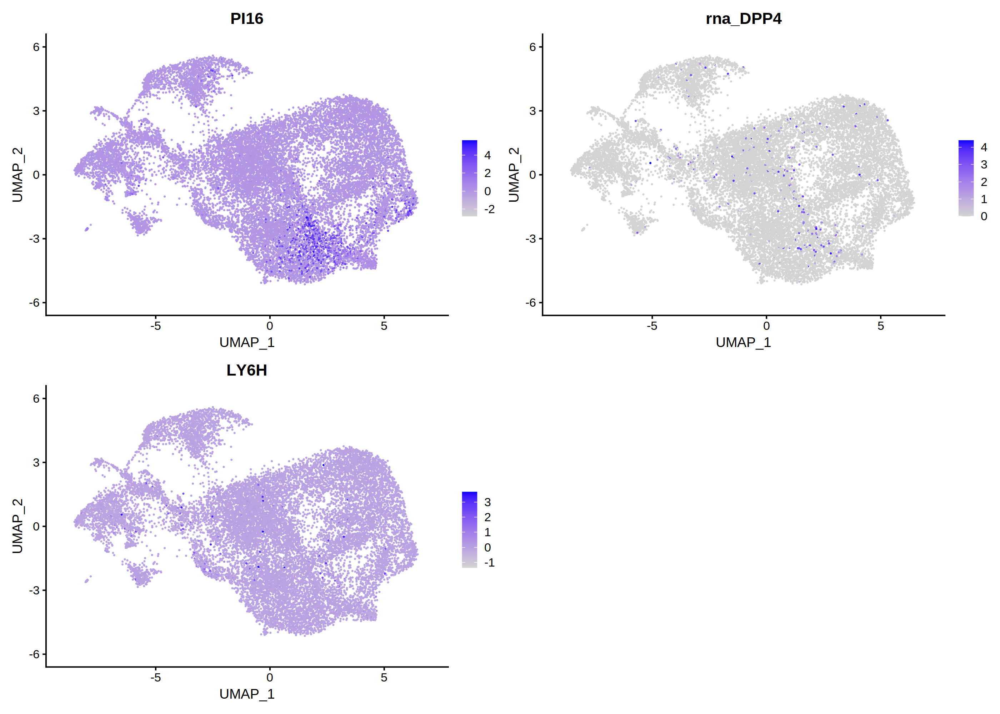

In [59]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("PI16","DPP4","LY6H"))


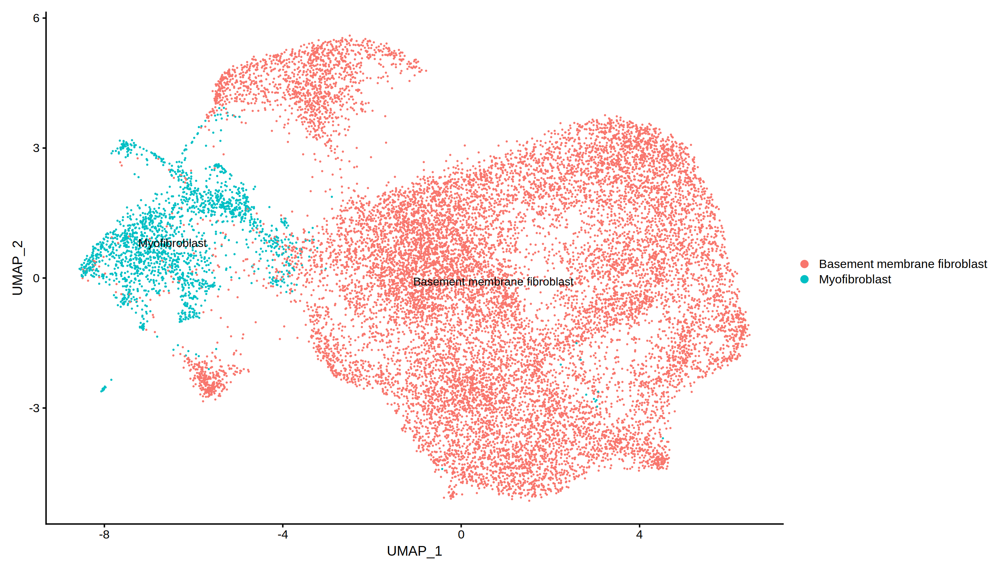

In [38]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

In [39]:
# save the subtypes
dataobj$sub.cell_type[colnames(dataobj) %in% colnames(subobj)] <- as.character(Idents(subobj))

### Reannotate Immune cell

In [40]:
subobj <- subset(dataobj,cell_type =="Immune cell")

In [41]:
subobj <- FindVariableFeatures(subobj) # default feature number, nfeatures = 2000
subobj <- ScaleData(subobj, features = VariableFeatures(subobj))

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
“selection.method set to 'vst' but count slot is empty; will use data slot instead”
Warning message in eval(predvars, data, env):
“NaNs produced”
Warning message in hvf.info$variance.expected[not.const] <- 10^fit$fitted:
“number of items to replace is not a multiple of replacement length”
Centering and scaling data matrix



PC_ 1 
Positive:  TNNI3, MYL7, TPM1, ACTC1, MYH7, TTN, TNNT2, SORBS2, MYL4, TNNI1 
	   CKM, MYL2, HBG2, MYL3, MYL9, HBA1, HBG1, HBA2, DES, HSPB7 
	   RYR2, NPPA, LDB3, HBB, CRYAB, ACTN2, MYOM1, FGF12, MYBPC3, PLN 
Negative:  CD74, PTPRC, ARHGAP15, B2M, MALAT1, HLA-DRA, HLA-DRB1, AOAH, HLA-B, SAMHD1 
	   CD53, HLA-DPA1, DOCK8, HLA-DPB1, HTR5A, SLC9A9, CSF1R, DEFB110, SKAP1, CST3 
	   HLA-DMA, ECEL1, RUNX1, HLA-E, ACTB, FYB1, MARCHF1, ITGB2, LAPTM5, PTPRCAP 
PC_ 2 
Positive:  CD74, CYBB, CSF1R, HLA-DRA, CST3, SAMHD1, MARCKS, C1QC, LYZ, S100A8 
	   HLA-DRB1, CD14, TYROBP, S100P, BPI, FTL, RBM47, RTN1, RETN, C1QA 
	   ATP8B4, HLA-DPA1, CTSB, KCTD12, AOAH, MAF, TRPS1, AZU1, MPO, MARCHF1 
Negative:  ITGB3, ITGA2B, TUBB1, DNM3, PF4, PPBP, GP1BA, GP9, MMRN1, CAVIN2 
	   THBS1, RIPOR3, TMEM40, MPIG6B, STON2, NRGN, RGS6, CLEC1B, TRIM58, ACRBP 
	   PKHD1L1, PTCRA, SLC2A3, DMTN, MFAP3L, KCNT2, CD226, MFSD2B, MYLK, ECE1 
PC_ 3 
Positive:  HBB, HBA1, HBA2, HBG2, HBG1, TTN, ALAS2, MYL7, TNNI3, MYH7 


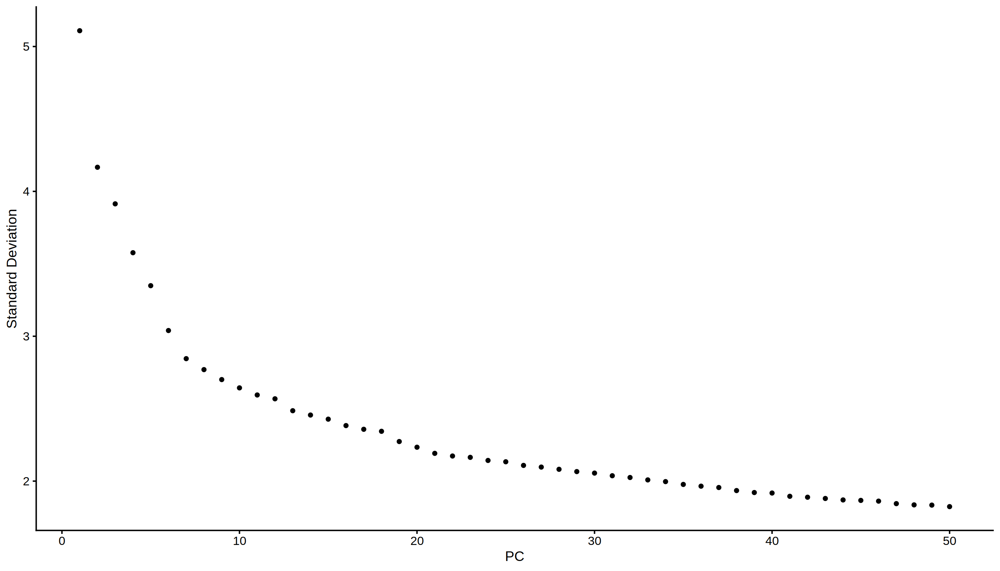

In [42]:
subobj <- RunPCA(subobj, features = VariableFeatures(object = subobj))
ElbowPlot(subobj,ndims=50) 

In [43]:
pcDim = 20

In [44]:
subobj <- RunUMAP(subobj, dims = 1:pcDim)
p_umap <- DimPlot(subobj, reduction = "umap", label = TRUE, pt.size=1)

23:16:57 UMAP embedding parameters a = 0.9922 b = 1.112

23:16:57 Read 4328 rows and found 20 numeric columns

23:16:57 Using Annoy for neighbor search, n_neighbors = 30

23:16:57 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

23:16:58 Writing NN index file to temp file /tmp/RtmpVfqaYf/file21bcdb3b59be9

23:16:58 Searching Annoy index using 1 thread, search_k = 3000

23:16:59 Annoy recall = 100%

23:16:59 Commencing smooth kNN distance calibration using 1 thread

23:17:00 Initializing from normalized Laplacian + noise

23:17:00 Commencing optimization for 500 epochs, with 190136 positive edges

23:17:05 Optimization finished



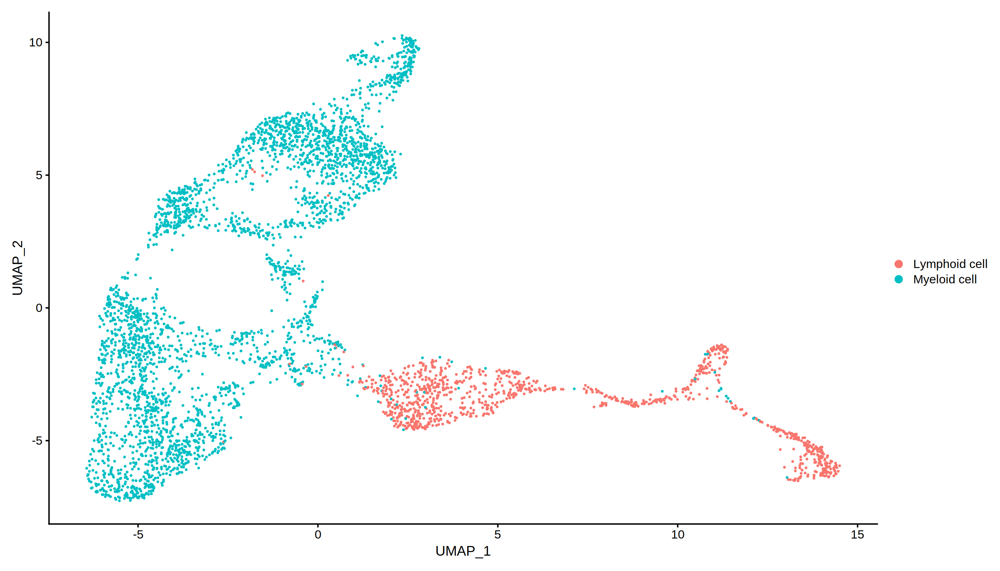

In [45]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj, reduction = "umap")

In [46]:
# Cluster the cells
subobj <- FindNeighbors(subobj, reduction = "pca", dims = 1:pcDim, nn.eps = 0.5)
subobj <- FindClusters(subobj, resolution = 0.1, n.start = 2)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 4328
Number of edges: 163594

Running Louvain algorithm...
Maximum modularity in 2 random starts: 0.9574
Number of communities: 5
Elapsed time: 0 seconds


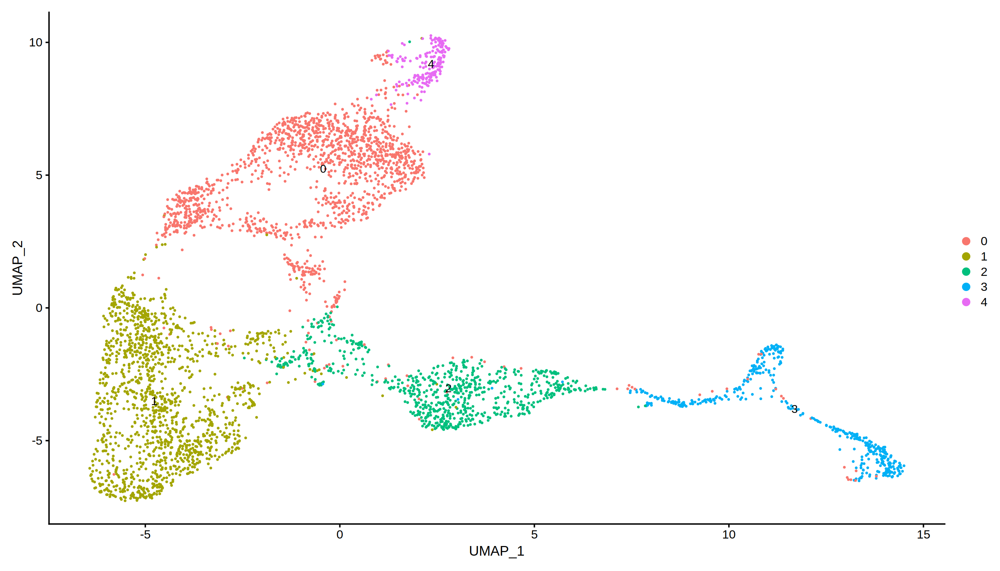

In [47]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

### Myeloid cell

Warning message:
“Could not find CD68 in the default search locations, found in RNA assay instead”


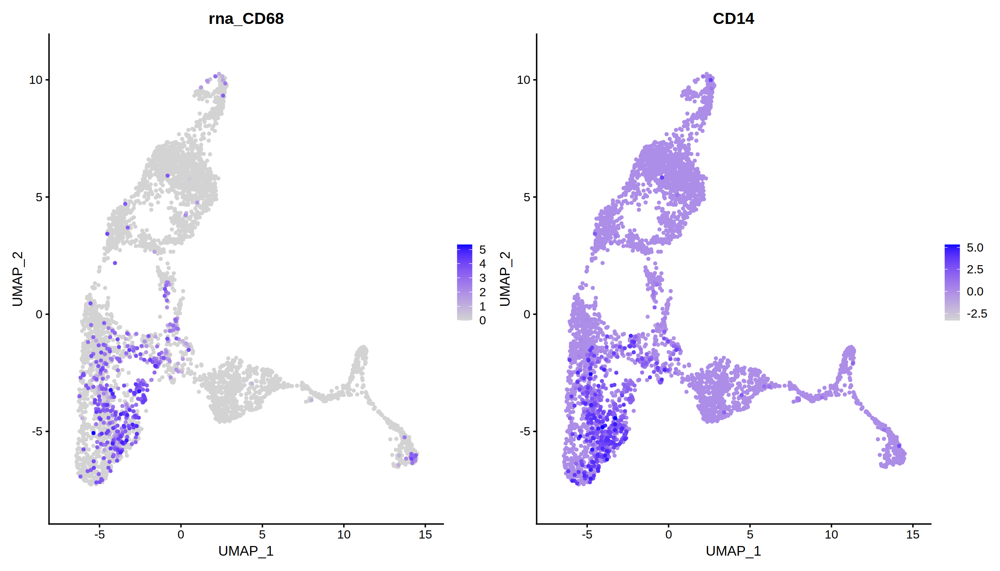

In [78]:
FeaturePlot(subobj,features = c("CD68","CD14"),pt.size = pt.size,order = T,ncol=2)

Warning message:
“Could not find CD3E in the default search locations, found in RNA assay instead”


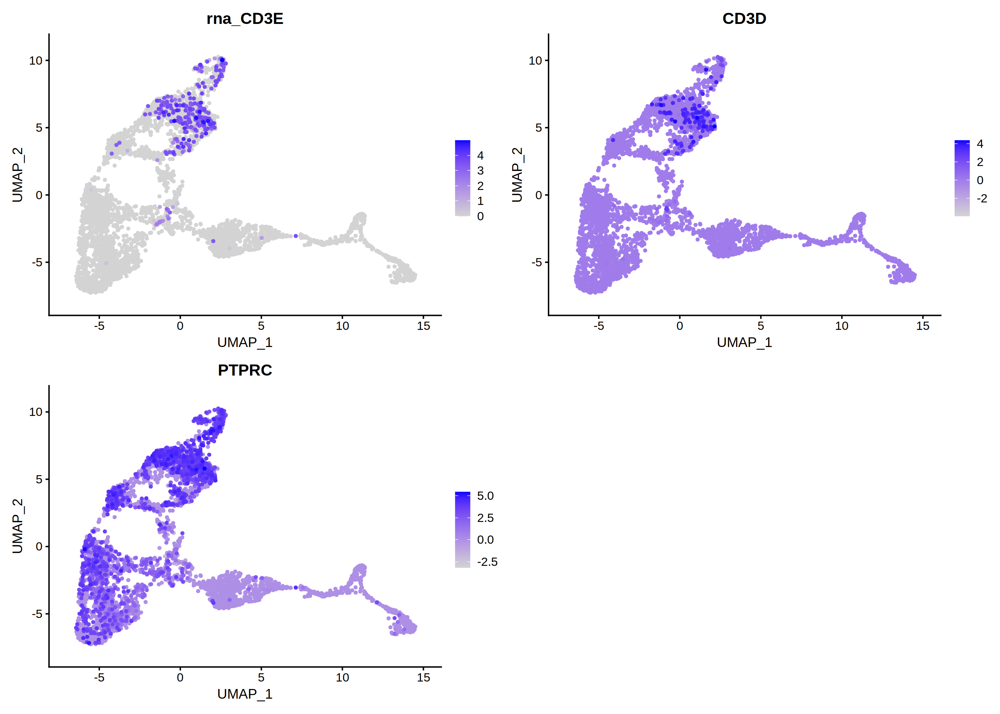

In [80]:
FeaturePlot(subobj,features = c("CD3E","CD3D","PTPRC"),pt.size = pt.size,order = T,ncol=2)

In [48]:
subobj <- RenameIdents(subobj,'1' = 'Myeloid cell',"0"="Lymphoid cell", "4"="Lymphoid cell", "2"="NA","3"="NA")

In [49]:
dataobj$cell_type[colnames(dataobj) %in% colnames(subobj)] <- as.character(Idents(subobj))

In [50]:
dataobj$cell_type[dataobj$cell_type=="NA"] <- "Unknown"

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



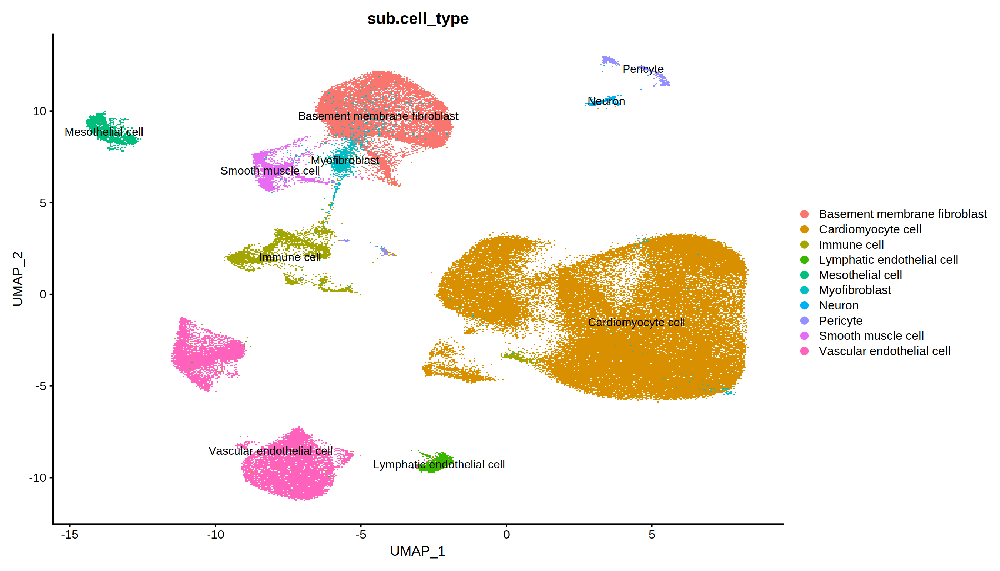

In [51]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(dataobj,reduction = "umap",label = T,group.by = "sub.cell_type")

### Reannotate Myeloid cell

In [52]:
subobj <- subset(dataobj,cell_type =="Myeloid cell")

In [53]:
subobj <- FindVariableFeatures(subobj) # default feature number, nfeatures = 2000
subobj <- ScaleData(subobj, features = VariableFeatures(subobj))

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
“selection.method set to 'vst' but count slot is empty; will use data slot instead”
Warning message in eval(predvars, data, env):
“NaNs produced”
Warning message in hvf.info$variance.expected[not.const] <- 10^fit$fitted:
“number of items to replace is not a multiple of replacement length”
Centering and scaling data matrix



PC_ 1 
Positive:  S100P, PGLYRP1, CDA, S100A8, HBD, PADI4, CHI3L1, OLFM4, MCEMP1, LCN2 
	   BPI, CD24P4, RGL4, TNR, RETN, FCN1, MS4A3, RPL7P26, HBZP1, MNDA 
	   S100A12, AZU1, NMRK2, LINC00534, MPO, CXCR2, KIF14, DES, PKLR, RBP7 
Negative:  PRSS57, HOXA6, GZMK, CD3D, SLC17A1, CLLU1-AS1, NWD2, GPC5-AS1, DCXR-DT, LINC00682 
	   FOXD2-AS1, MBL2, HBBP1, OXGR1, HOXA11, OPRD1, ARLNC1, OR51I1, MIR4732, CCAT1 
	   BARHL2, HTR2A-AS1, SPINK6, CST11, REG1CP, PVRIG, VSTM2B, ATP12A, SAMD15, FUT5 
PC_ 2 
Positive:  PRSS57, HOXA6, GZMK, RPL19P12, DCXR-DT, C9orf43, GMNC, TCL1A, CCAT1, CLIC3 
	   CLEC14A, MPIG6B, KLHL31, TRARG1, HBBP1, FUT5, IL1RL1, SMR3B, SPATA16, MMRN1 
	   SCN7A, MIR4732, SYNPO2, CYP17A1-AS1, SOX7, TAC1, CCDC141, ADNP-AS1, CTSW, CHRDL1 
Negative:  REG1CP, CST11, HTR2A-AS1, SPINK6, BARHL2, ATP12A, VSTM2B, OXGR1, OPRD1, UBQLNL 
	   FOXD2-AS1, IRX6, ARLNC1, CLLU1-AS1, EXOC3L4, NWD2, FAM167A-AS1, PLGLB1, SLC17A1, HOXA5 
	   TAS2R19, PGLYRP1, LINC01013, HBD, CDA, TNR, PADI4, GPC5-AS1, S1

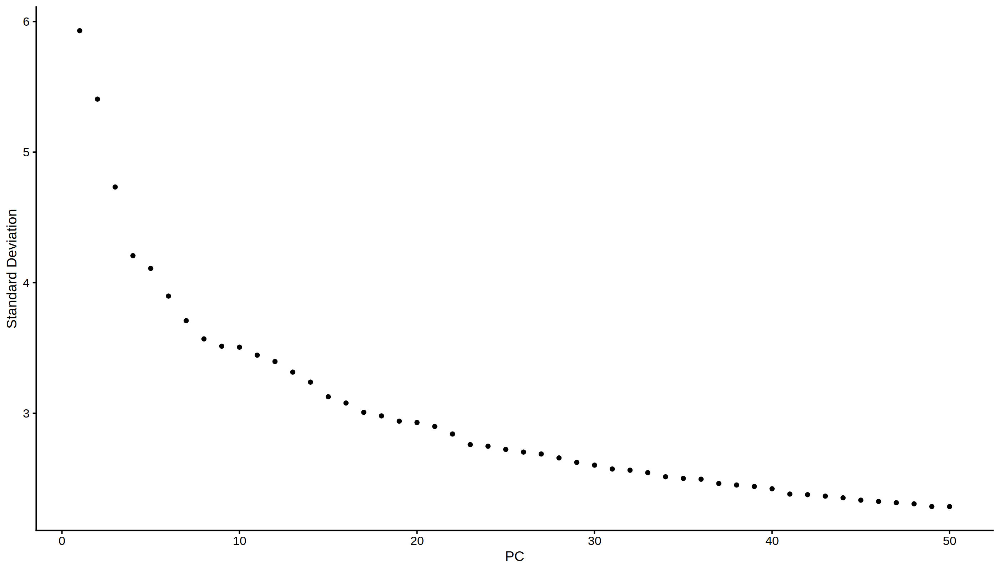

In [54]:
subobj <- RunPCA(subobj, features = VariableFeatures(object = subobj))
ElbowPlot(subobj,ndims=50) 

In [55]:
pcDim = 30

In [56]:
subobj <- RunUMAP(subobj, dims = 1:pcDim)
p_umap <- DimPlot(subobj, reduction = "umap", label = TRUE, pt.size=1)

23:17:50 UMAP embedding parameters a = 0.9922 b = 1.112

23:17:50 Read 1435 rows and found 30 numeric columns

23:17:50 Using Annoy for neighbor search, n_neighbors = 30

23:17:50 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

23:17:50 Writing NN index file to temp file /tmp/RtmpVfqaYf/file21bcdb16db8a8f

23:17:50 Searching Annoy index using 1 thread, search_k = 3000

23:17:51 Annoy recall = 100%

23:17:51 Commencing smooth kNN distance calibration using 1 thread

23:17:52 Initializing from normalized Laplacian + noise

23:17:52 Commencing optimization for 500 epochs, with 65954 positive edges

23:17:53 Optimization finished



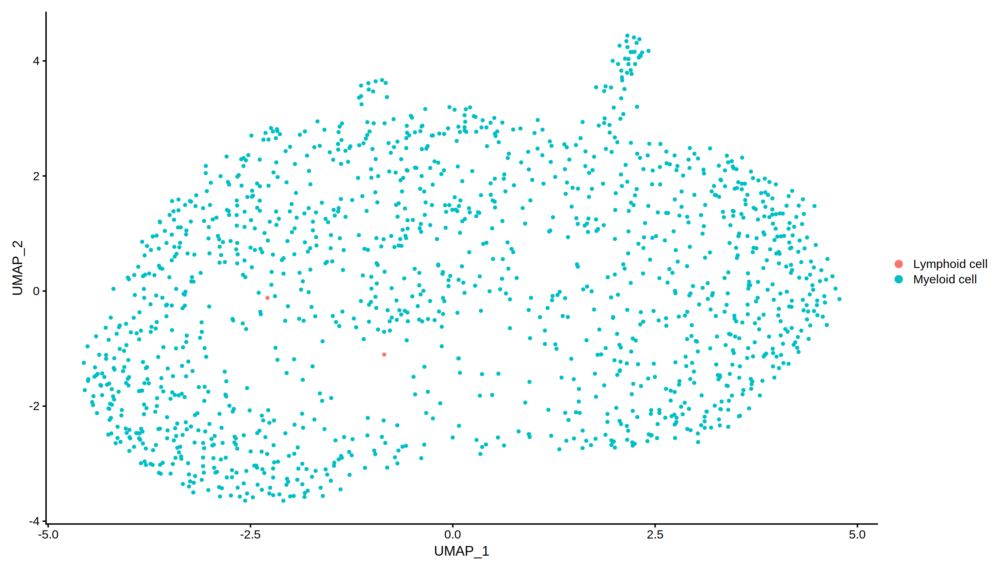

In [57]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj, reduction = "umap")

In [58]:
# Cluster the cells
subobj <- FindNeighbors(subobj, reduction = "pca", dims = 1:pcDim, nn.eps = 0.5)
subobj <- FindClusters(subobj, resolution = 0.8, n.start = 2)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 1435
Number of edges: 68303

Running Louvain algorithm...
Maximum modularity in 2 random starts: 0.6937
Number of communities: 8
Elapsed time: 0 seconds


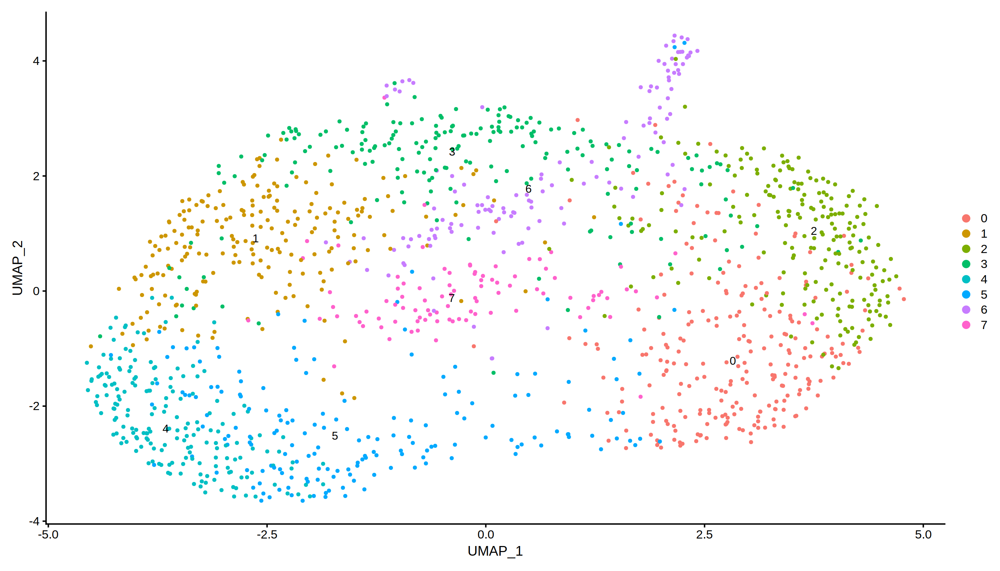

In [116]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

Warning message:
“Could not find CD68 in the default search locations, found in RNA assay instead”


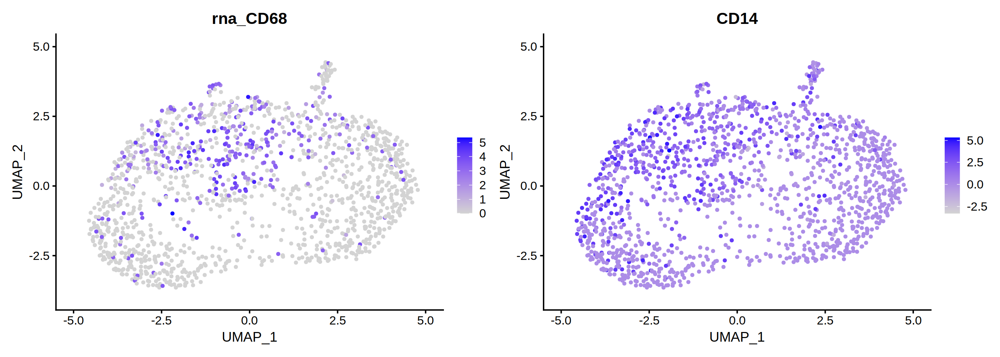

In [117]:
options(repr.plot.width=14, repr.plot.height=5, repr.plot.res = 200)
FeaturePlot(subobj,c("CD68","CD14"))

#### Neutrophilic granulocyte

Warning message:
“Could not find S100A9 in the default search locations, found in RNA assay instead”


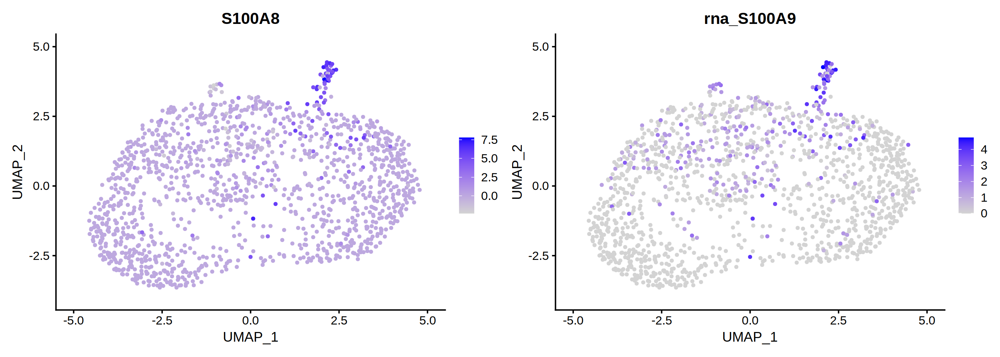

In [118]:
options(repr.plot.width=14, repr.plot.height=5, repr.plot.res = 200)
FeaturePlot(subobj,c("S100A8","S100A9"))


Warning message:
“Could not find S100A9 in the default search locations, found in RNA assay instead”


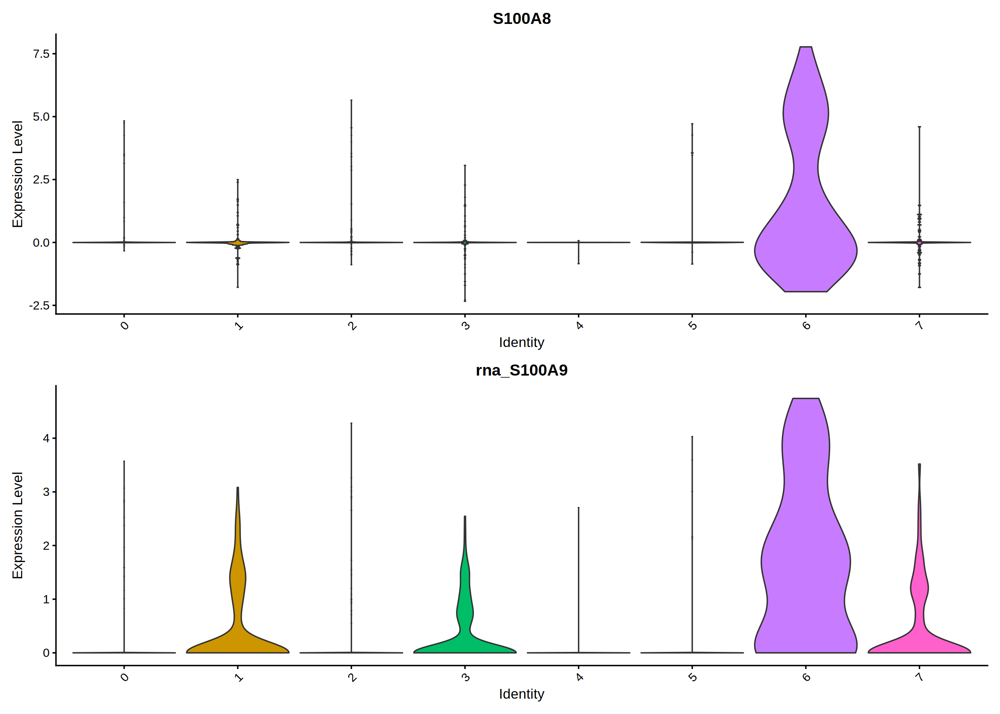

In [119]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(subobj,features = c("S100A8","S100A9"),pt.size = 0,ncol=1)

In [59]:
subobj <- RenameIdents(object = subobj,'6' = 'Neutrophilic granulocyte')

#### Mast cell

Warning message:
“Could not find CPA3 in the default search locations, found in RNA assay instead”
Warning message in FeaturePlot(subobj, c("MS4A2", "CPA3", "TPSAB1")):
“All cells have the same value (0) of rna_CPA3.”


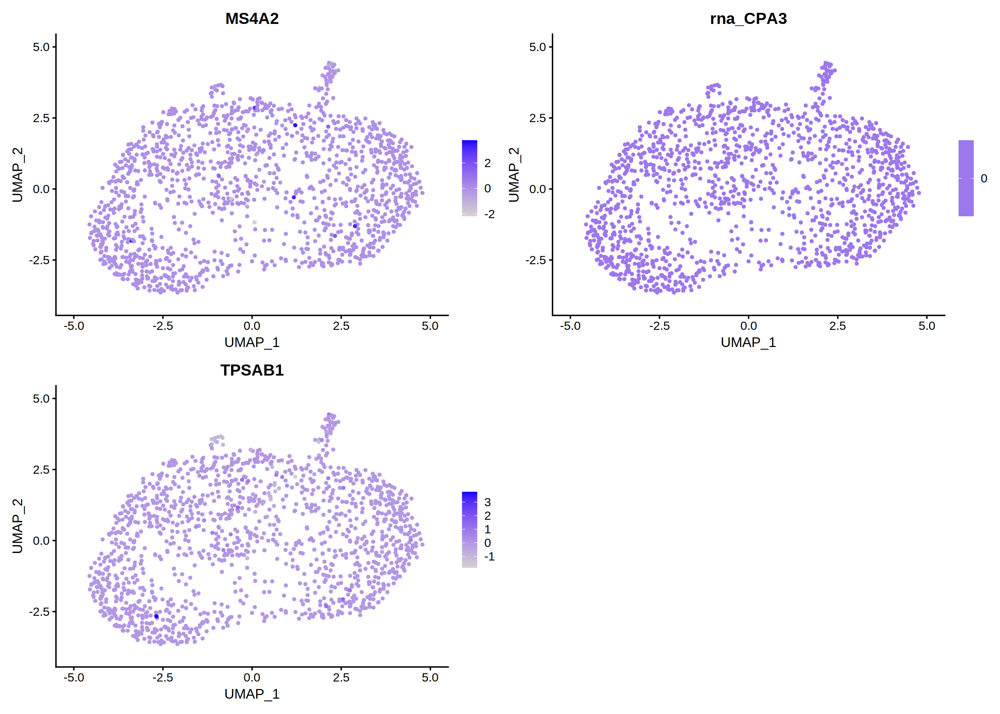

In [120]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("MS4A2","CPA3","TPSAB1"))


Warning message:
“Could not find CPA3 in the default search locations, found in RNA assay instead”
Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of rna_CPA3.”


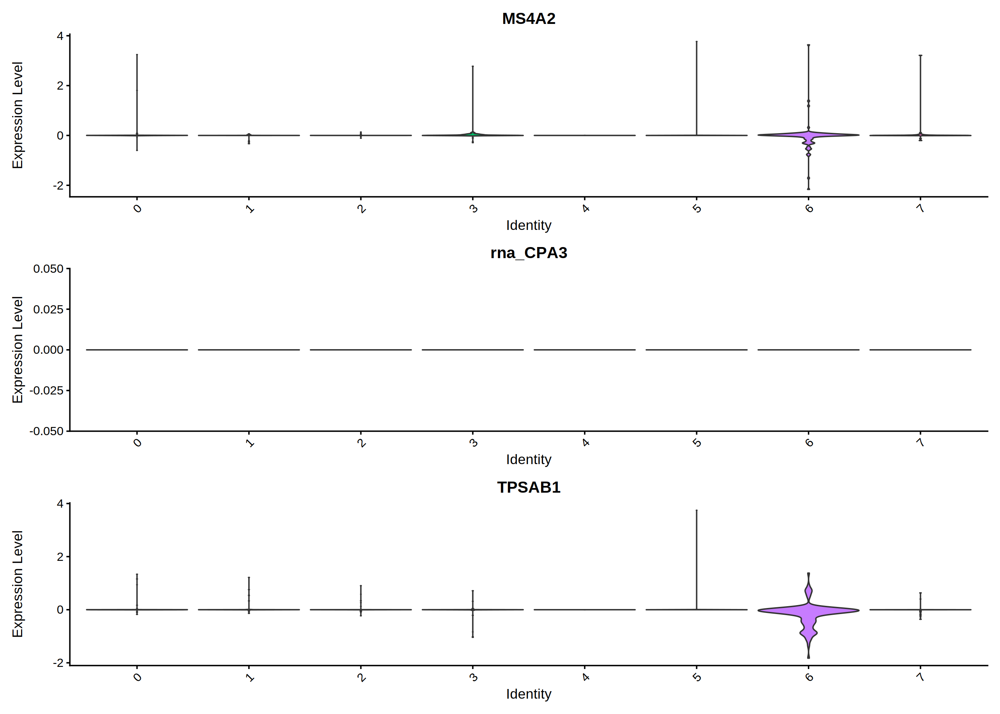

In [121]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(subobj,features = c("MS4A2","CPA3","TPSAB1"),pt.size = 0,ncol=1)

### Dendritic cell

Warning message:
“Could not find CCND1 in the default search locations, found in RNA assay instead”


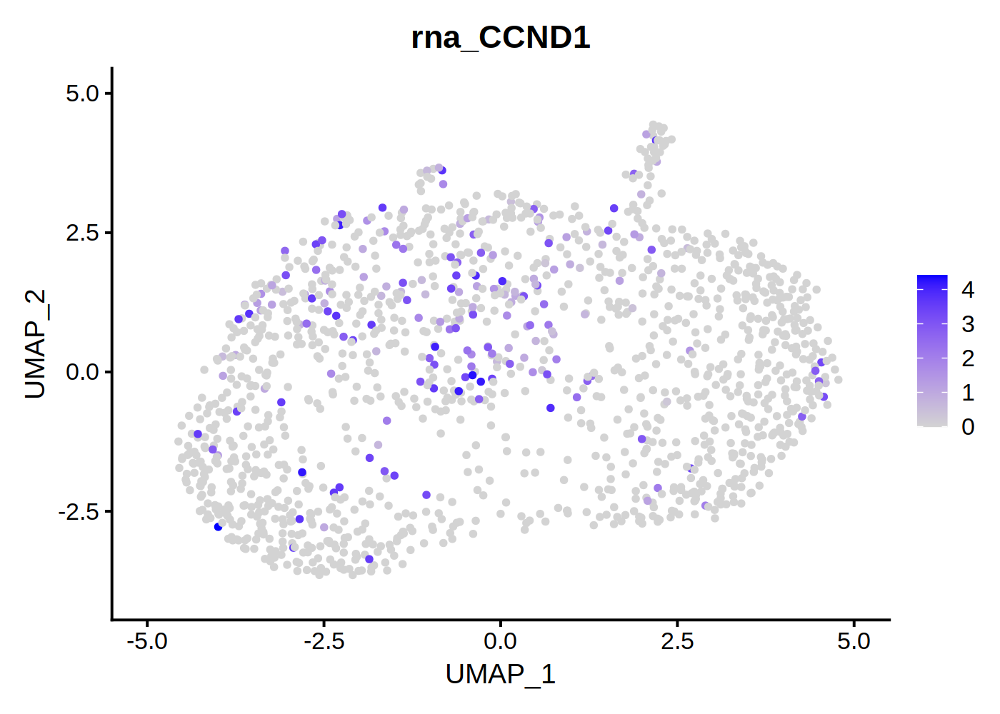

In [123]:
options(repr.plot.width=7, repr.plot.height=5, repr.plot.res = 200)
FeaturePlot(subobj,c("CCND1"))

### Monocyte

Warning message:
“Could not find PLAC8 in the default search locations, found in RNA assay instead”
Warning message in FeaturePlot(subobj, c("CD14", "FCGR3A", "PLAC8")):
“All cells have the same value (0) of rna_PLAC8.”


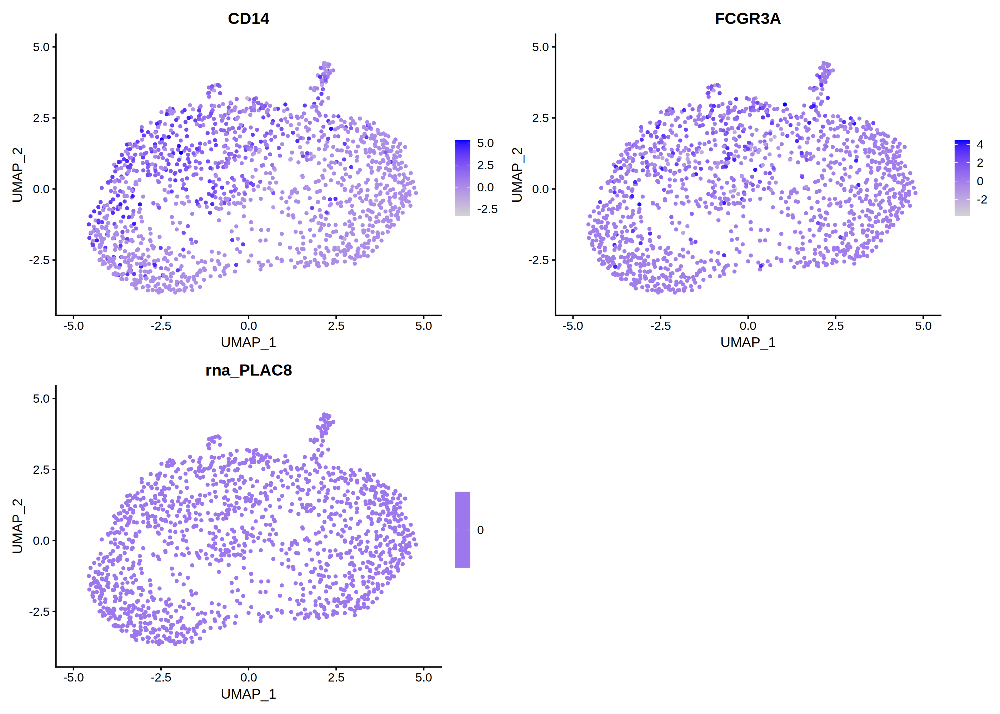

In [124]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("CD14","FCGR3A","PLAC8"))

Warning message:
“Could not find PLAC8 in the default search locations, found in RNA assay instead”
Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of rna_PLAC8.”


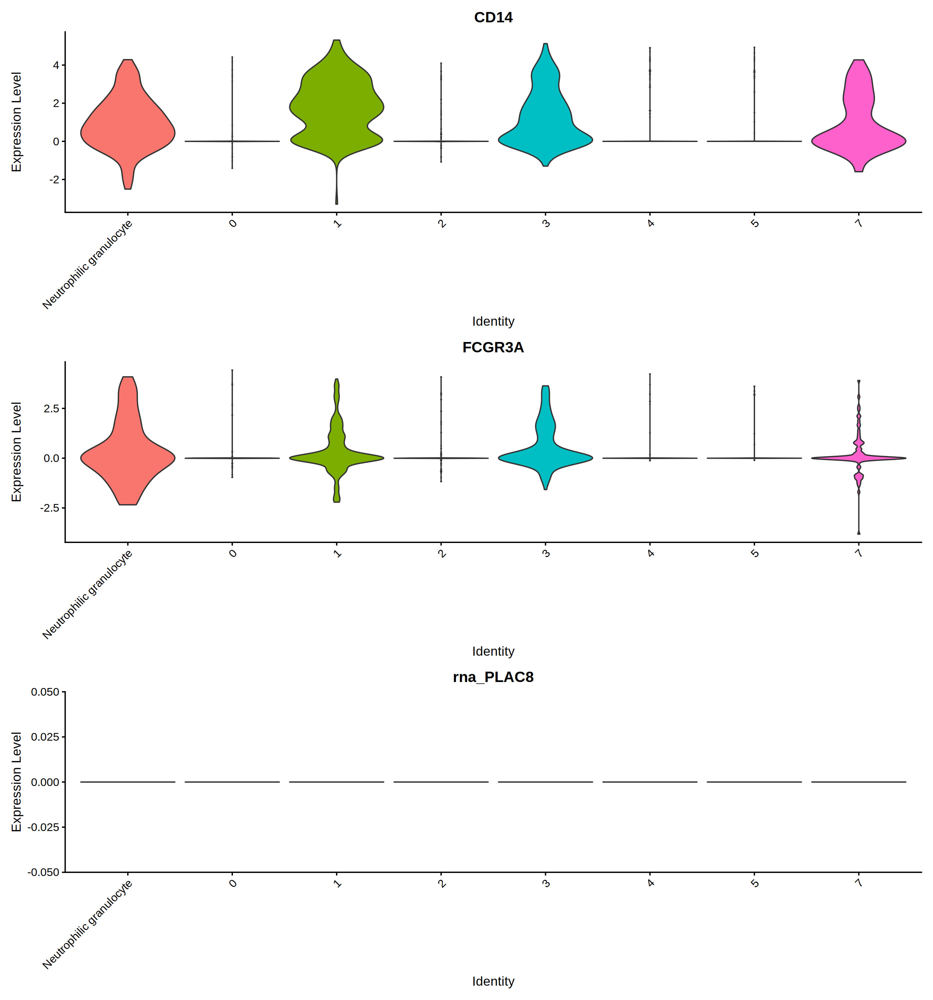

In [125]:
options(repr.plot.width=14, repr.plot.height=5*3, repr.plot.res = 200)

VlnPlot(subobj,features = c("CD14","FCGR3A","PLAC8"),pt.size = 0,ncol=1)

### Macrophage

Warning message:
“Could not find PLAC8 in the default search locations, found in RNA assay instead”
Warning message in FeaturePlot(subobj, c("PLAC8", "MSR1", "MRC1")):
“All cells have the same value (0) of rna_PLAC8.”


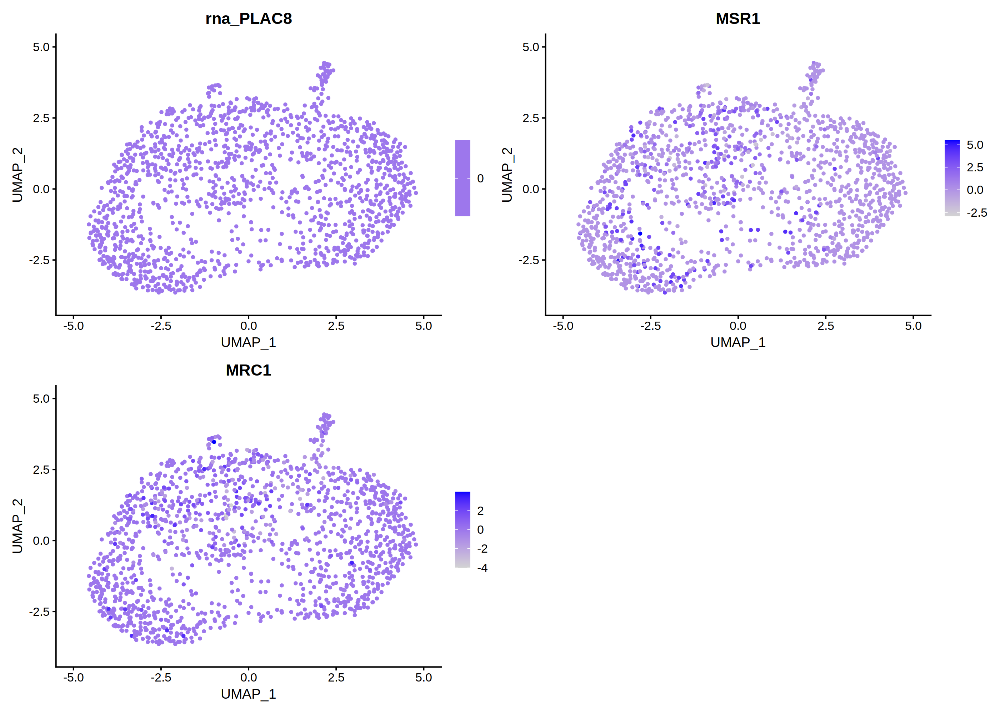

In [126]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)
FeaturePlot(subobj,c("PLAC8","MSR1","MRC1"))

Warning message:
“Could not find PLAC8 in the default search locations, found in RNA assay instead”
Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of rna_PLAC8.”


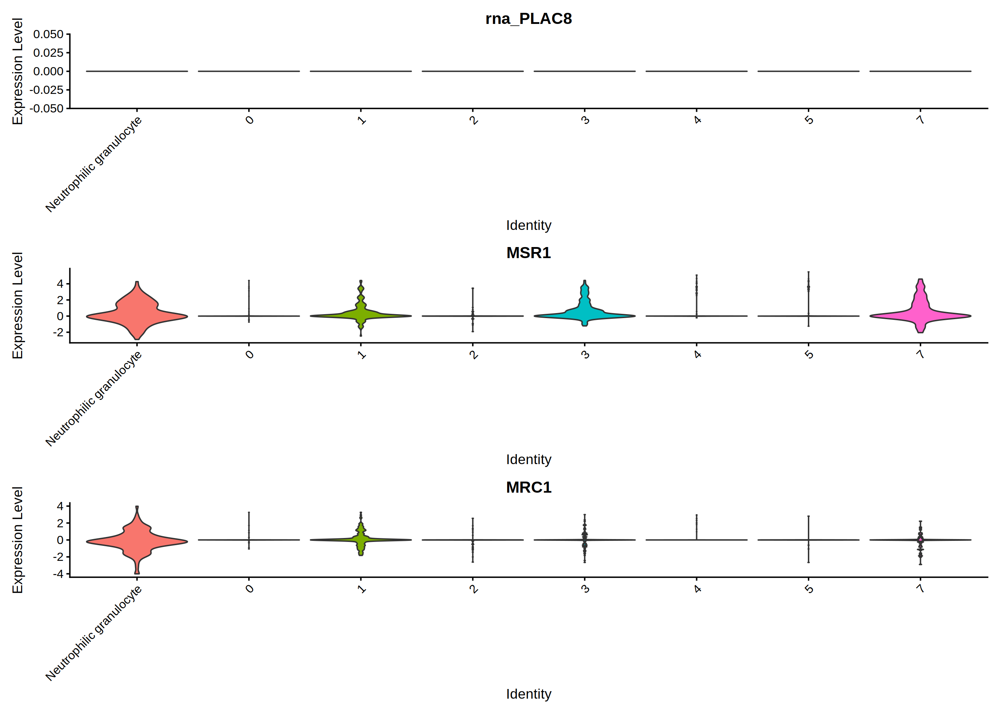

In [127]:
options(repr.plot.width=14, repr.plot.height=5*2, repr.plot.res = 200)

VlnPlot(subobj,features = c("PLAC8","MSR1","MRC1"),pt.size = 0,ncol=1)

In [60]:
subobj <- RenameIdents(object = subobj,'0' = 'Macrophage','1'='Macrophage','2'='Macrophage','3'='Macrophage','4'='Macrophage','5'='Macrophage','7'='Macrophage')

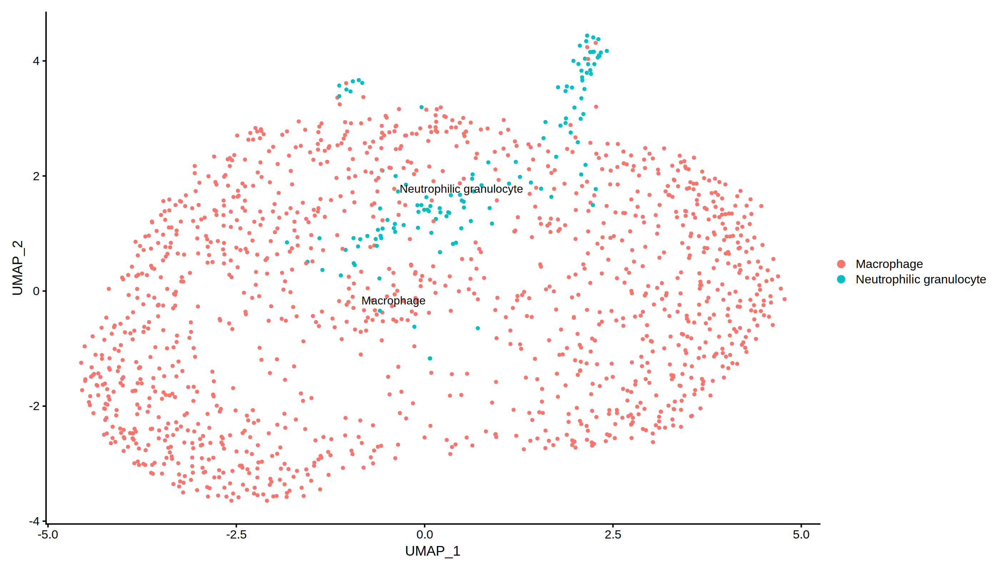

In [61]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

In [62]:
# save the subtypes
dataobj$sub.cell_type[colnames(dataobj) %in% colnames(subobj)] <- as.character(Idents(subobj))

### Reannotate Lymphoid cell

In [63]:
subobj <- subset(dataobj,cell_type =="Lymphoid cell")

In [64]:
subobj <- FindVariableFeatures(subobj) # default feature number, nfeatures = 2000
subobj <- ScaleData(subobj, features = VariableFeatures(subobj))

Warning message in FindVariableFeatures.Assay(object = assay.data, selection.method = selection.method, :
“selection.method set to 'vst' but count slot is empty; will use data slot instead”
Warning message in eval(predvars, data, env):
“NaNs produced”
Warning message in hvf.info$variance.expected[not.const] <- 10^fit$fitted:
“number of items to replace is not a multiple of replacement length”
Centering and scaling data matrix



PC_ 1 
Positive:  CRABP2, THBS1, THBD, TPSB2, CTSG, KCNB2, PHOX2A, COL5A2, MRC1, CALB2 
	   RBP7, LIMCH1, DUSP6, CSRP2, PLA2G2A, TYROBP, TBXAS1, PCSK1N, CXCL8, HAPLN1 
	   IGF1, FCGR2A, AHSP, CCL20, DPYSL3, LRRC70, CADM2, MT1X, LENG8-AS1, TPSAB1 
Negative:  NT5C3AP1, A4GNT, VTRNA1-2, PLGLB1, HELT, FAM71E2, SMARCA5-AS1, PYDC2, IBSP, STX19 
	   OR6C76, LINC00410, HAPP, PCDHGA1, SMAD5-AS1, TRAPPC3L, EIF4EBP3, TACR2, RAET1G, PGA5 
	   RPSAP14, ALX3, BPESC1, LINC00221, CXCL14, HSD3B2, FST, MAGEB16, CARTPT, GPR50 
PC_ 2 
Positive:  PCDHGA1, A4GNT, FAM71E2, VTRNA1-2, SMARCA5-AS1, HELT, PYDC2, STX19, STAB2, PRKCZ-AS1 
	   NT5C3AP1, PLGLB1, XCL2, NXPH3, NKG7, KLRC1, TPTE2P2, RPL5P5, CST7, TYROBP 
	   EIF3EP1, CLIC3, SLC7A10, SPEG, MS4A3, PPP1R3C, MPO, MT-ATP6, GNLY, PRSS57 
Negative:  GPR50, NOXO1, CARTPT, MAGEB16, RPSAP14, KRT82, PRSS58, IFITM5, ALDH1L1-AS2, LINC00052 
	   PLBD1-AS1, DPYD-AS2, HOXB9, LINC00682, RPL36AP26, YWHAEP1, KCNIP2-AS1, HTR1E, CCKAR, HTR2A-AS1 
	   TRPM5, RBMS3-AS1, OR51

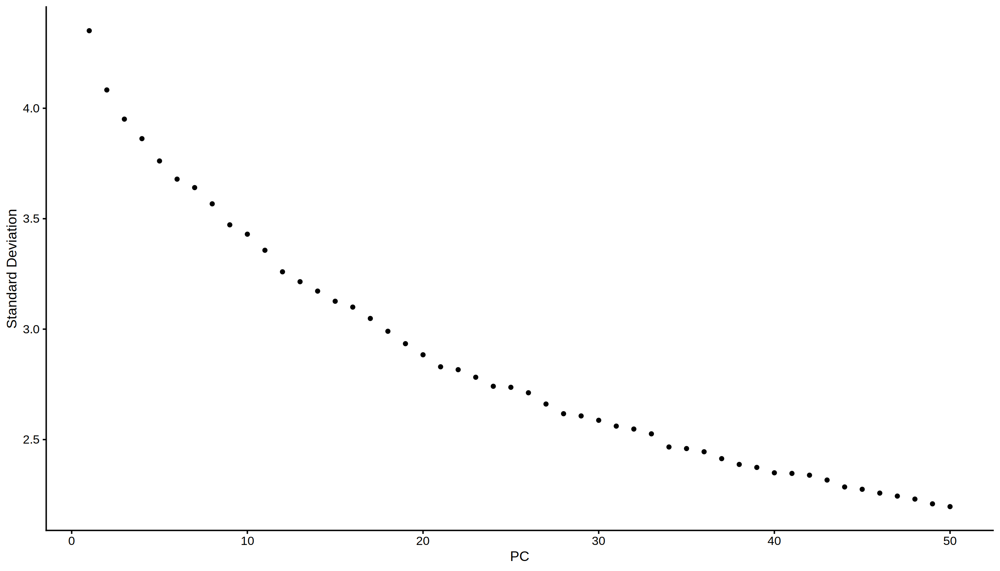

In [65]:
subobj <- RunPCA(subobj, features = VariableFeatures(object = subobj))
ElbowPlot(subobj,ndims=50) 

In [77]:
pcDim = 30

In [78]:
subobj <- RunUMAP(subobj, dims = 1:pcDim)
p_umap <- DimPlot(subobj, reduction = "umap", label = TRUE, pt.size=1)

23:19:43 UMAP embedding parameters a = 0.9922 b = 1.112

23:19:43 Read 1716 rows and found 30 numeric columns

23:19:43 Using Annoy for neighbor search, n_neighbors = 30

23:19:43 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

23:19:43 Writing NN index file to temp file /tmp/RtmpVfqaYf/file21bcdb7da25eff

23:19:43 Searching Annoy index using 1 thread, search_k = 3000

23:19:44 Annoy recall = 100%

23:19:44 Commencing smooth kNN distance calibration using 1 thread

23:19:45 Initializing from normalized Laplacian + noise

23:19:45 Commencing optimization for 500 epochs, with 80688 positive edges

23:19:47 Optimization finished



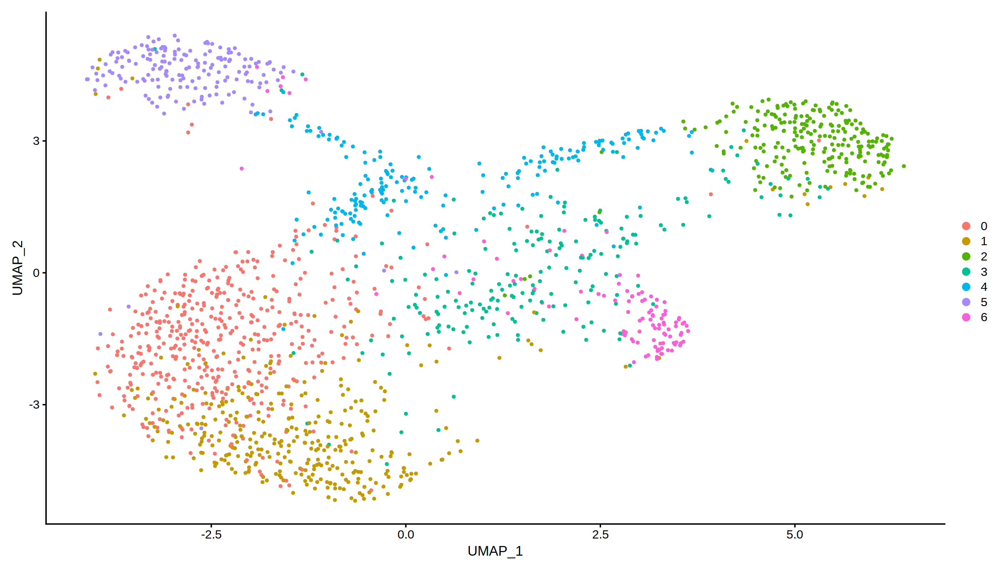

In [79]:
DimPlot(subobj, reduction = "umap")

In [80]:
# Cluster the cells
subobj <- FindNeighbors(subobj, reduction = "pca", dims = 1:pcDim, nn.eps = 0.5)
subobj <- FindClusters(subobj, resolution = 1, n.start = 6)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 1716
Number of edges: 86787

Running Louvain algorithm...
Maximum modularity in 6 random starts: 0.6793
Number of communities: 8
Elapsed time: 0 seconds


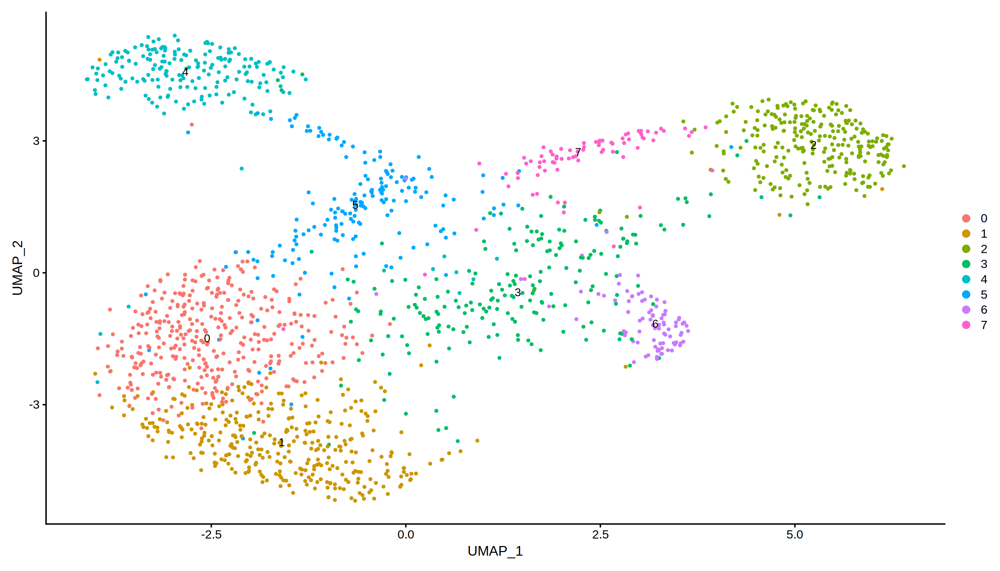

In [81]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(subobj,reduction = "umap",label = T)

### B cell

Warning message:
“Could not find CD24 in the default search locations, found in RNA assay instead”


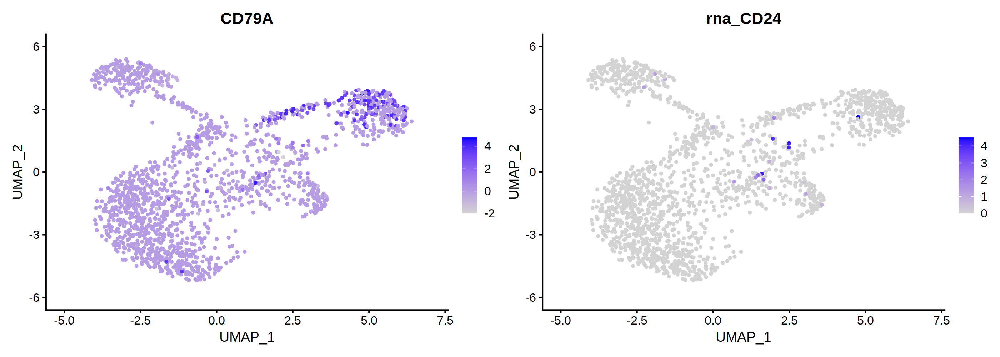

In [82]:
options(repr.plot.width=14, repr.plot.height=5, repr.plot.res = 200)
FeaturePlot(subobj,c("CD79A","CD24"))

In [83]:
subobj <- RenameIdents(object = subobj,'2' = 'B cell','7' = 'B cell')

### T cell

Warning message:
“Could not find CD3E in the default search locations, found in RNA assay instead”
Warning message:
“Could not find CD8A in the default search locations, found in RNA assay instead”
Warning message:
“Could not find CD4 in the default search locations, found in RNA assay instead”


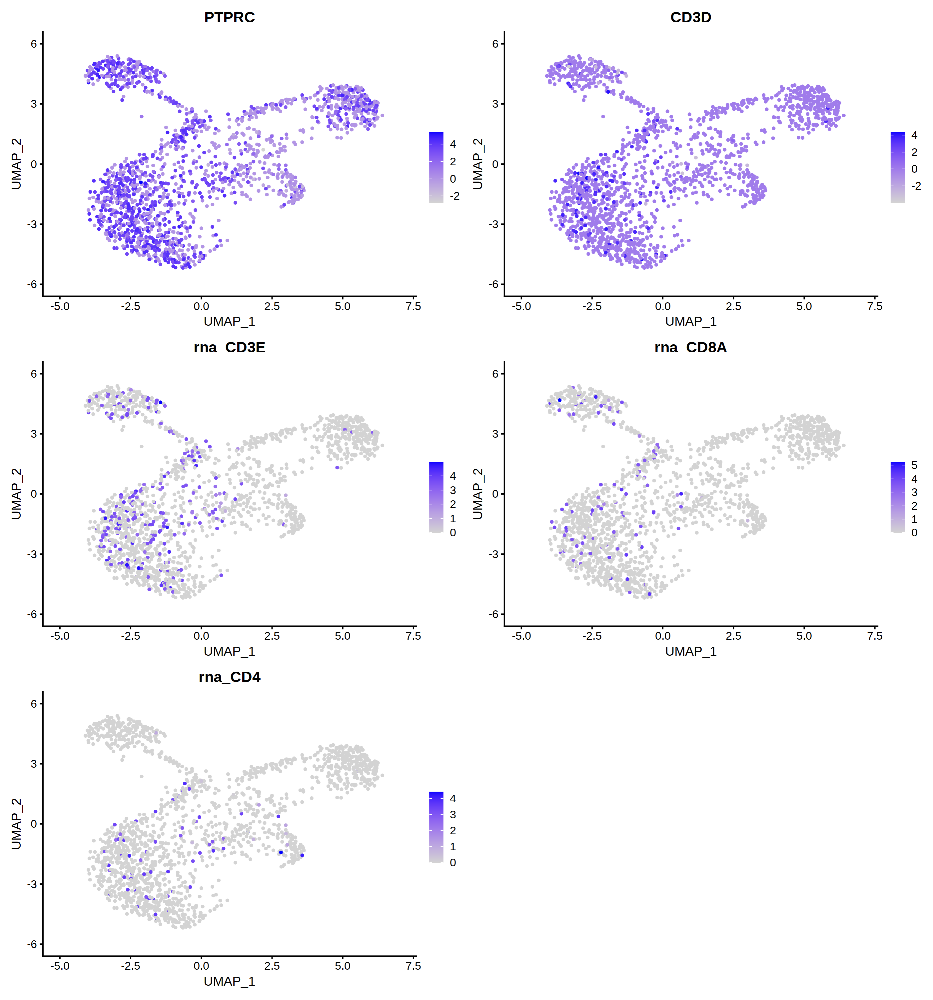

In [87]:
options(repr.plot.width=14, repr.plot.height=5*3, repr.plot.res = 200)
FeaturePlot(subobj,c("PTPRC","CD3D","CD3E","CD8A","CD4"))

In [88]:
subobj <- RenameIdents(object = subobj,'0' = 'T cell','1' = 'T cell','3' = 'T cell','5' = 'T cell','6' = 'T cell')

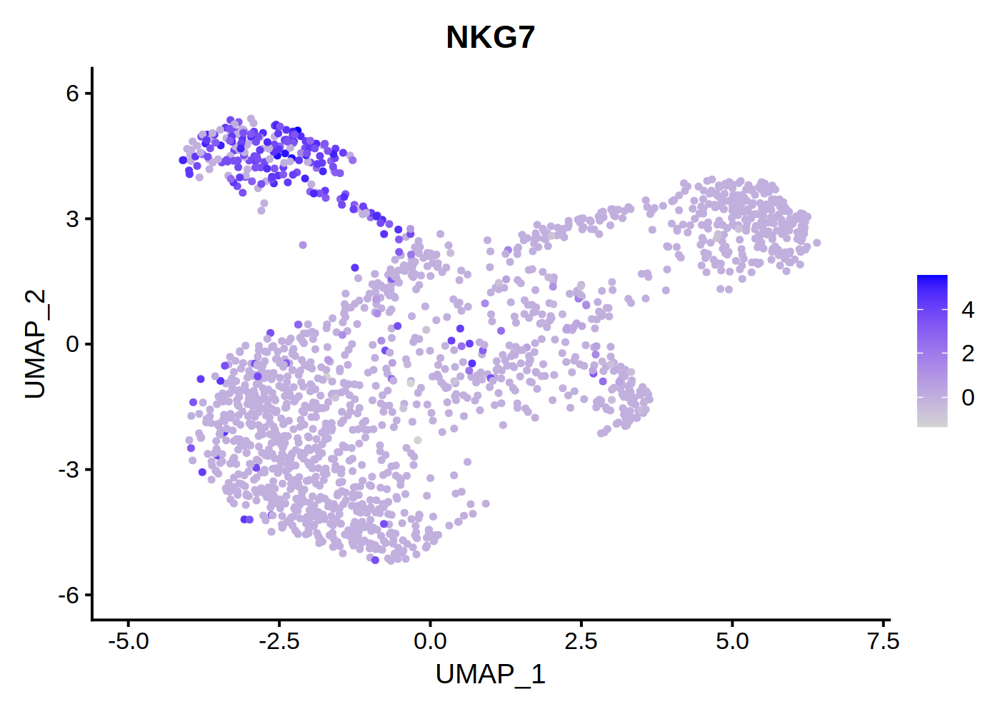

In [85]:
options(repr.plot.width=7, repr.plot.height=5, repr.plot.res = 200)
FeaturePlot(subobj,c("NKG7"))

In [89]:
subobj <- RenameIdents(object = subobj,'4' = 'NK cell')

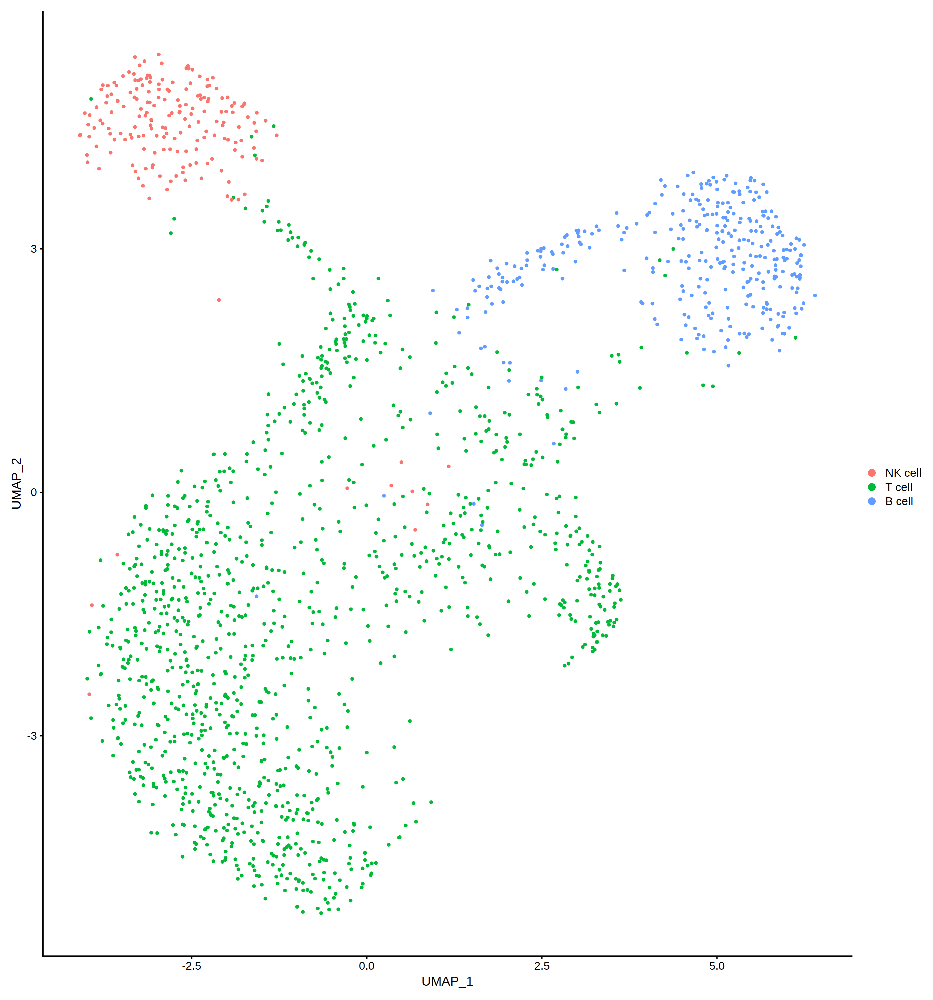

In [90]:
DimPlot(subobj)

In [91]:
# save the subtypes
dataobj$sub.cell_type[colnames(dataobj) %in% colnames(subobj)] <- as.character(Idents(subobj))

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



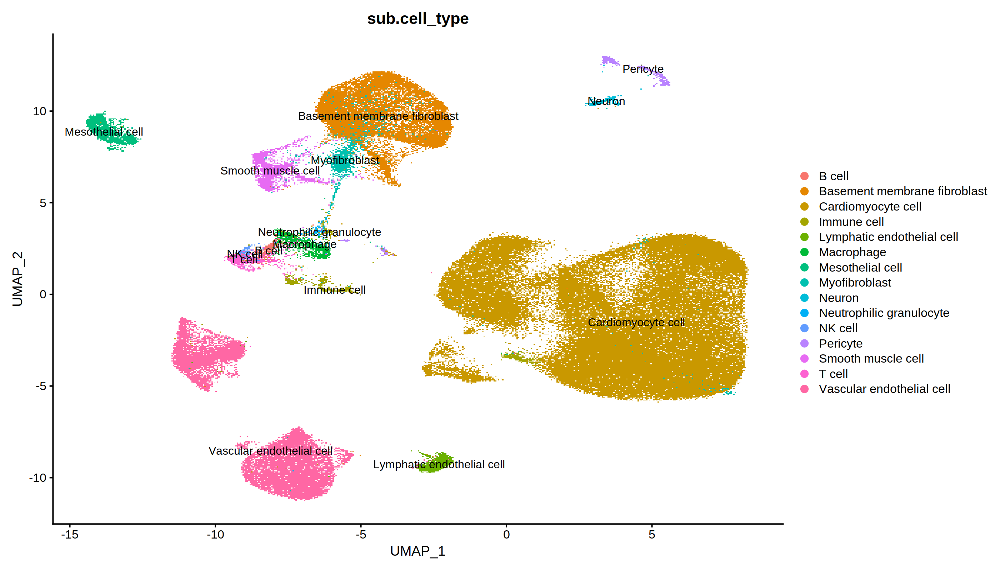

In [92]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(dataobj,reduction = "umap",label = T,group.by = "sub.cell_type")

In [93]:
obj.int$MCT <- dataobj$cell_type
obj.int$cell_type <- dataobj$sub.cell_type

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



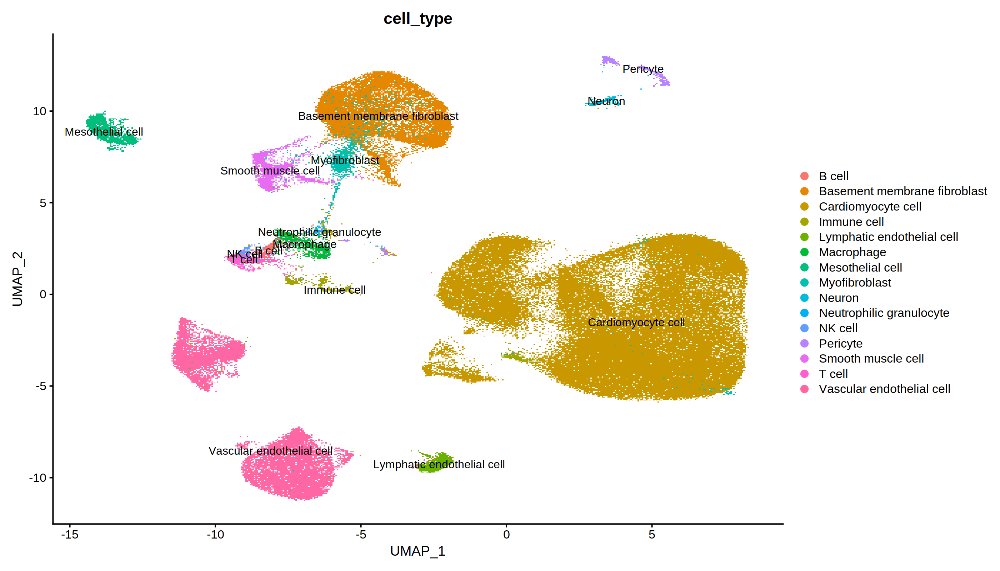

In [94]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(obj.int,reduction = "umap",label = T,group.by = "cell_type")

Rasterizing points since number of points exceeds 100,000.
To disable this behavior set `raster=FALSE`



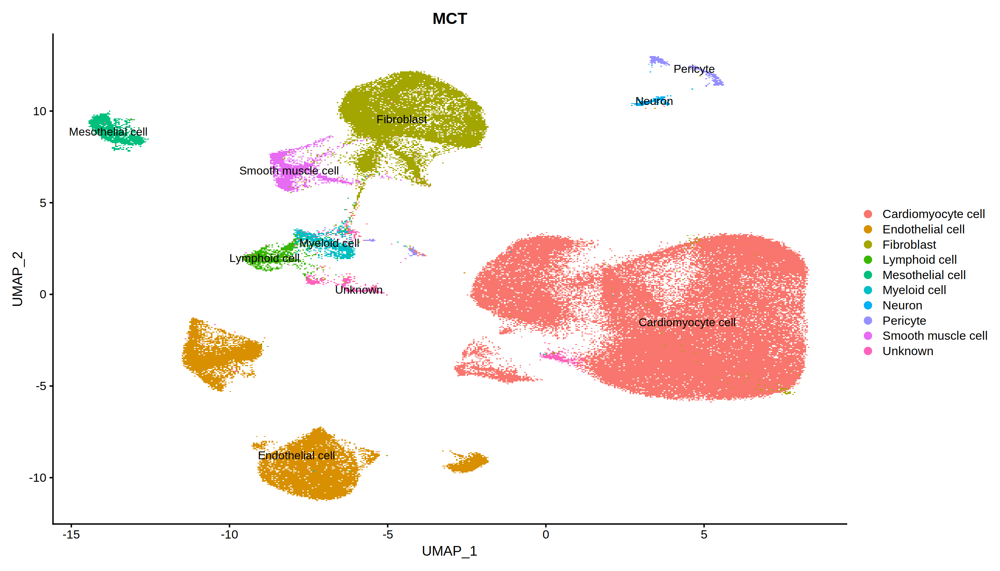

In [95]:
options(repr.plot.width=14, repr.plot.height=8, repr.plot.res = 200)
DimPlot(obj.int,reduction = "umap",label = T,group.by = "MCT")

In [96]:
saveRDS(obj.int,"/data3/cyx/Fetal.Heart.integrated.rds")

In [106]:
obj.int$seurat_cluster <- "NA"

In [107]:
obj.int@meta.data <- obj.int@meta.data[,c("cell_ID", "donor_ID", "donor_gender", "donor_age", "original_name", "organ", "region", "subregion", "sample_status", "seq_tech", "cell_type", "seurat_cluster", "if_patient", "donor_status", "treatment", "ethnicity", "Ref", "MCT", "develop_stage", "PC_1", "PC_2", "TSNE_1", "TSNE_2", "UMAP_1", "UMAP_2")]

In [97]:
as_matrix <- function(mat){
    tmp <- matrix(data=0L, nrow = mat@Dim[1], ncol = mat@Dim[2])
    row_pos <- mat@i+1
    col_pos <- findInterval(seq(mat@x)-1,mat@p[-1])+1
    val <- mat@x
    for (i in seq_along(val)){
        tmp[row_pos[i],col_pos[i]] <- val[i]
    }

    row.names(tmp) <- mat@Dimnames[[1]]
    colnames(tmp) <- mat@Dimnames[[2]]
    return(tmp)
}


In [98]:
matrix.expression.1 <- as_matrix(obj.int@assays$RNA@data)

In [108]:
matrix.all.1 <- cbind(t(matrix.expression.1[order(row.names(matrix.expression.1)),]) ,obj.int@meta.data)
matrix.all.1$cid <- c(901148:(901147+dim(obj.int)[2]))

In [109]:
901147+dim(obj.int)[2]

[1] 1018508

In [110]:
#rm(matrix.expression.1)
write.table(matrix.all.1, quote=FALSE, "/data3/cyx//ForDatabase0419/09.csv",sep=",",col.names = T,row.names = FALSE)

In [111]:
df <- obj.int@meta.data[c("cell_type",'PC_1','PC_2','TSNE_1','TSNE_2','UMAP_1','UMAP_2')]
df <- df[order(df$cell_type),]

In [112]:
write.csv(df[,c("cell_type","PC_1","PC_2")],"/data3/cyx/ForDatabase0419/Fetal_dotplot/PCA.csv")

In [113]:
write.csv(df[,c("cell_type","TSNE_1","TSNE_2")],"/data3/cyx/ForDatabase0419/Fetal_dotplot/TSNE.csv")

In [114]:
write.csv(df[,c("cell_type","UMAP_1","UMAP_2")],"/data3/cyx/ForDatabase0419/Fetal_dotplot/UMAP.csv")